In [1]:
%matplotlib inline

In [2]:
import astra
import numpy as np
import pylab as plt
import os
import glob

import matplotlib
font = {'size'   : 18}
matplotlib.rc('font', **font)

In [3]:
def log_progress(sequence, every=None, size=None):
    from ipywidgets import IntProgress, HTML, VBox
    from IPython.display import display

    is_iterator = False
    if size is None:
        try:
            size = len(sequence)
        except TypeError:
            is_iterator = True
    if size is not None:
        if every is None:
            if size <= 200:
                every = 1
            else:
                every = size / 200     # every 0.5%
    else:
        assert every is not None, 'sequence is iterator, set every'

    if is_iterator:
        progress = IntProgress(min=0, max=1, value=1)
        progress.bar_style = 'info'
    else:
        progress = IntProgress(min=0, max=size, value=0)
    label = HTML()
    box = VBox(children=[label, progress])
    display(box)

    index = 0
    try:
        for index, record in enumerate(sequence, 1):
            if index == 1 or index % every == 0:
                if is_iterator:
                    label.value = '{index} / ?'.format(index=index)
                else:
                    progress.value = index
                    label.value = u'{index} / {size}'.format(
                        index=index,
                        size=size
                    )
            yield record
    except:
        progress.bar_style = 'danger'
        raise
    else:
        progress.bar_style = 'success'
        progress.value = index
        label.value = unicode(index or '?')

In [4]:
def images_diff(im1, im2):
    assert(im1.shape==im2.shape)
    rec_diff = np.zeros(shape=(im1.shape[0],im1.shape[1],3), dtype='float32')
    im1_t = im1.copy()
    im1_t = (im1_t-im1_t.min())/(im1_t.max()-im1_t.min())
    
    im2_t = im2.copy()
    im2_t = (im2_t-im2_t.min())/(im2_t.max()-im2_t.min())
    
    # nrecon_rec_t[nrecon_rec_t<0] = 0
    diff_rec = im1_t-im2_t
    rec_diff[...,0] = diff_rec*(diff_rec>0)
    rec_diff[...,1] = -diff_rec*(diff_rec<0)
    rec_diff[...,2] = rec_diff[...,1]
    return rec_diff

In [5]:
data_root = '/diskmnt/a/makov/yaivan/MMC_1/'
nrecon_root_folder = os.path.join(data_root,'_tmp','nrecon')
nrecon_folders = glob.glob(os.path.join(nrecon_root_folder, '*'))
nrecon_folders = [nf for nf in nrecon_folders if os.path.isdir(nf)]
print len(nrecon_folders)

160


In [69]:
!ls -la /diskmnt/a/makov/yaivan/MMC_1/Raw/*.tif | wc -l
!ls -la /diskmnt/a/makov/yaivan/MMC_1/Raw/*.iif | wc -l

2030
25


In [70]:
2030/25

81

In [6]:
!ls /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_*

/diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0:
MMC1_2.82um__pp1.tif	  MMC1_2.82um__rec_spr.bmp
MMC1_2.82um__pp2.tif	  MMC1_2.82um__sino0960.tif
MMC1_2.82um__rec0960.png  MMC1_2.82um__sinoraw_0960.tif
MMC1_2.82um__rec.log	  tomo_config.log

/diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_10:
MMC1_2.82um__pp1.tif	  MMC1_2.82um__rec_spr.bmp
MMC1_2.82um__pp2.tif	  MMC1_2.82um__sino0960.tif
MMC1_2.82um__rec0960.png  MMC1_2.82um__sinoraw_0960.tif
MMC1_2.82um__rec.log	  tomo_config.log

/diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_15:
MMC1_2.82um__pp1.tif	  MMC1_2.82um__rec_spr.bmp
MMC1_2.82um__pp2.tif	  MMC1_2.82um__sino0960.tif
MMC1_2.82um__rec0960.png  MMC1_2.82um__sinoraw_0960.tif
MMC1_2.82um__rec.log	  tomo_config.log

/diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20:
MMC1_2.82um__pp1.tif	  MMC1_2.82um__rec_spr.bmp
MMC1_2.82um__pp2.tif	  MMC1_2.82um__sino0960.tif
MMC1_2.82um__rec0960.png  MMC1_2.82um__sinoraw_0960.tif
MMC1_2.82um__rec.log	  tomo_config.log

/diskmnt/a/ma

In [7]:
!md5sum /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0/*

325de73e8a7ffd28d3c46a17e5dc0507  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0/MMC1_2.82um__pp1.tif
b17850f9074113f5c98efd8edbe299b1  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0/MMC1_2.82um__pp2.tif
b6dc4d5a0424a0b166698480ab4d1bfb  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0/MMC1_2.82um__rec.log
b59255f863cf5de8096d0c08fbb9bdf4  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0/MMC1_2.82um__rec0960.png
d9dc20997adef1bd29aa51fd7501255a  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0/MMC1_2.82um__rec_spr.bmp
7469b253506ba3ec1a46c6bb2d6abcc3  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0/MMC1_2.82um__sino0960.tif
255653aff1082fd0df059edd6bac7c05  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0/MMC1_2.82um__sinoraw_0960.tif
dc670627de54acccffcb891b860062bc  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_0/tomo_config.log


In [8]:
!md5sum /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/*

325de73e8a7ffd28d3c46a17e5dc0507  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__pp1.tif
b17850f9074113f5c98efd8edbe299b1  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__pp2.tif
734c0ee97af91502c0b077ee314a5f8b  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__rec.log
0a717143717bc98a14aecf26b656e5dc  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__rec0960.png
d9dc20997adef1bd29aa51fd7501255a  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__rec_spr.bmp
a4d17fa74cfa8a0e0c58ee4d5175e119  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__sino0960.tif
255653aff1082fd0df059edd6bac7c05  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__sinoraw_0960.tif
d70be2dd7ab4c7039d470b30bd3a47cd  /diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/tomo_config.log


In [12]:
nrecon_folder = [d for d in nrecon_folders if 'bh_0_rc_0' in d][0]
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sino0960.tif')
sinogram0 = plt.imread(data_file).astype('float32')
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sinoraw_0960.tif')
sinraw0 = plt.imread(data_file).astype('float32')
rec_file = os.path.join(nrecon_folder, 'MMC1_2.82um__rec0960.png')
rec0 = plt.imread(rec_file).astype('float32')

In [13]:
nrecon_folder = [d for d in nrecon_folders if 'bh_0_rc_10' in d][0]
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sino0960.tif')
sinogram10 = plt.imread(data_file).astype('float32')
rec_file = os.path.join(nrecon_folder, 'MMC1_2.82um__rec0960.png')
rec10 = plt.imread(rec_file).astype('float32')

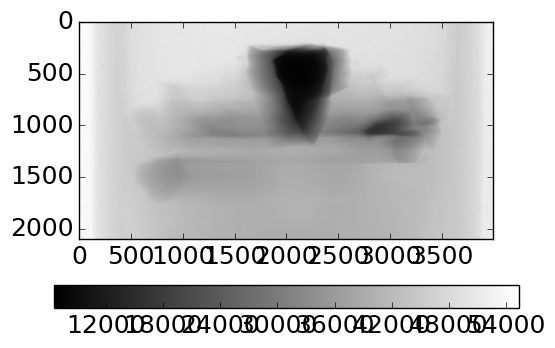

In [14]:
t = plt.imread('/diskmnt/a/makov/yaivan/MMC_1/Raw/MMC1_2.82um__arc.tif')
plt.imshow(t, cmap=plt.cm.gray)
plt.colorbar(orientation='horizontal')

In [15]:
data_files = glob.glob('/diskmnt/a/makov/yaivan/MMC_1/Raw/MMC1_2.82um_????.tif')
data_files = sorted(data_files)
print(len(data_files))

2030


In [16]:
s0=np.diff(sinogram10[:,2000]-sinogram0[:,2000])
edges = np.argwhere(np.abs(s0)>5)

In [61]:
def get_points(x):
    return x.ravel()
#     return np.hstack([x[:, 1:11].ravel(),x[:, -12:2].ravel()])
                      
t_arc = plt.imread('/diskmnt/a/makov/yaivan/MMC_1/Raw/MMC1_2.82um__arc.tif').astype('float32')

res = []
for df in log_progress(data_files[0:1000:5]):
    t_proj =plt.imread(df).astype('float32')
    res.append(np.std(t_proj))

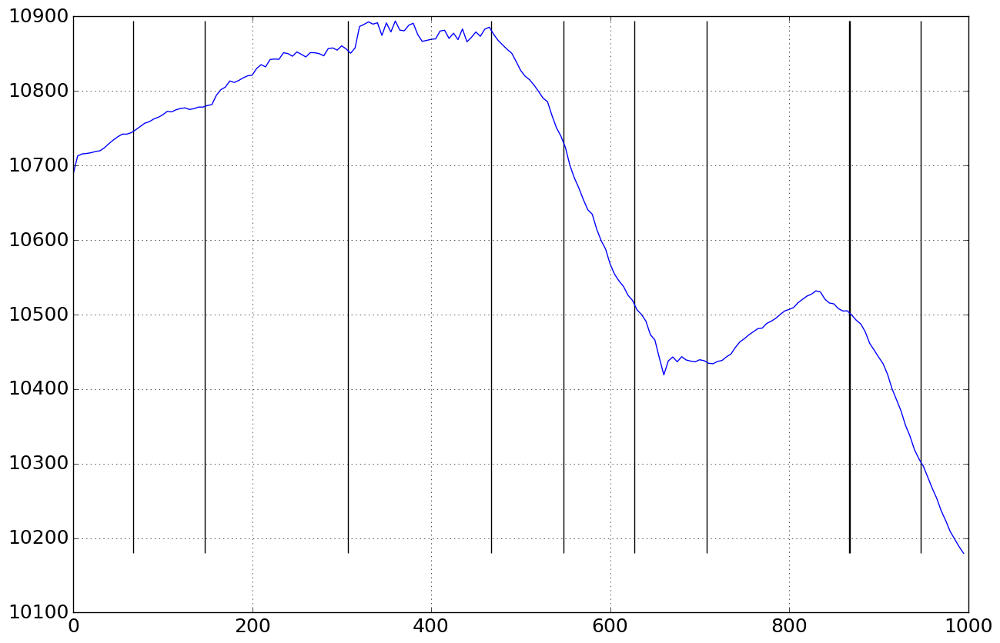

In [62]:
plt.figure(figsize=(15,10))
plt.plot(np.arange(0,5*len(res),5),res)
for e in edges:
    if e<1000:
        plt.vlines(e,np.min(res),np.max(res))
plt.grid()

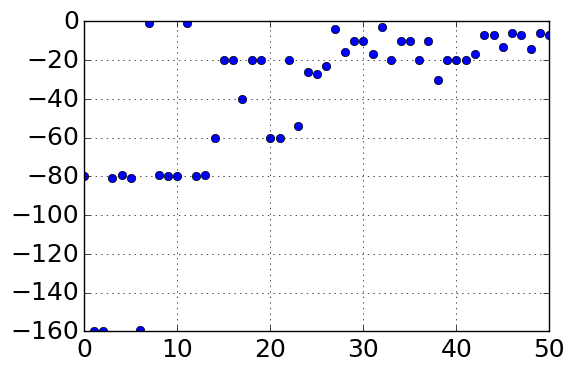

In [68]:
plt.plot(edges[:-1]-edges[1:],'o')
plt.grid()

In [10]:
nrecon_folder = [d for d in nrecon_folders if 'bh_0_rc_5' in d][0]
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sino0960.tif')
sinogram5 = plt.imread(data_file).astype('float32')
rec_file = os.path.join(nrecon_folder, 'MMC1_2.82um__rec0960.png')
rec5 = plt.imread(rec_file).astype('float32')

In [12]:
nrecon_folder = [d for d in nrecon_folders if 'bh_0_rc_15' in d][0]
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sino0960.tif')
sinogram15 = plt.imread(data_file).astype('float32')
rec_file = os.path.join(nrecon_folder, 'MMC1_2.82um__rec0960.png')
rec15 = plt.imread(rec_file).astype('float32')

In [13]:
nrecon_folder = [d for d in nrecon_folders if 'bh_0_rc_20' in d][0]
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sino0960.tif')
sinogram20 = plt.imread(data_file).astype('float32')
rec_file = os.path.join(nrecon_folder, 'MMC1_2.82um__rec0960.png')
rec20 = plt.imread(rec_file).astype('float32')

In [14]:
nrecon_folder = [d for d in nrecon_folders if 'bh_92_rc_0' in d][0]
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sino0960.tif')
sinogram0_bh = plt.imread(data_file).astype('float32')
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sinoraw_0960.tif')
sinraw0_bh = plt.imread(data_file).astype('float32')
rec_file = os.path.join(nrecon_folder, 'MMC1_2.82um__rec0960.png')
rec0_bh = plt.imread(rec_file).astype('float32')

In [15]:
nrecon_folder = [d for d in nrecon_folders if 'bh_92_rc_20' in d][0]
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sino0960.tif')
sinogram20_bh = plt.imread(data_file).astype('float32')
data_file = os.path.join(nrecon_folder, 'MMC1_2.82um__sinoraw_0960.tif')
sinraw20_bh = plt.imread(data_file).astype('float32')
rec_file = os.path.join(nrecon_folder, 'MMC1_2.82um__rec0960.png')
rec20_bh = plt.imread(rec_file).astype('float32')

In [16]:
data_file = os.path.join('/home/makov/Downloads/', 'MMC1_2.82um__sino1040.tif')
sinogram1040 = plt.imread(data_file).astype('float32')
rec1040 = plt.imread(
    os.path.join('/home/makov/Downloads/', 'MMC1_2.82um__rec1040.png')).astype('float32')

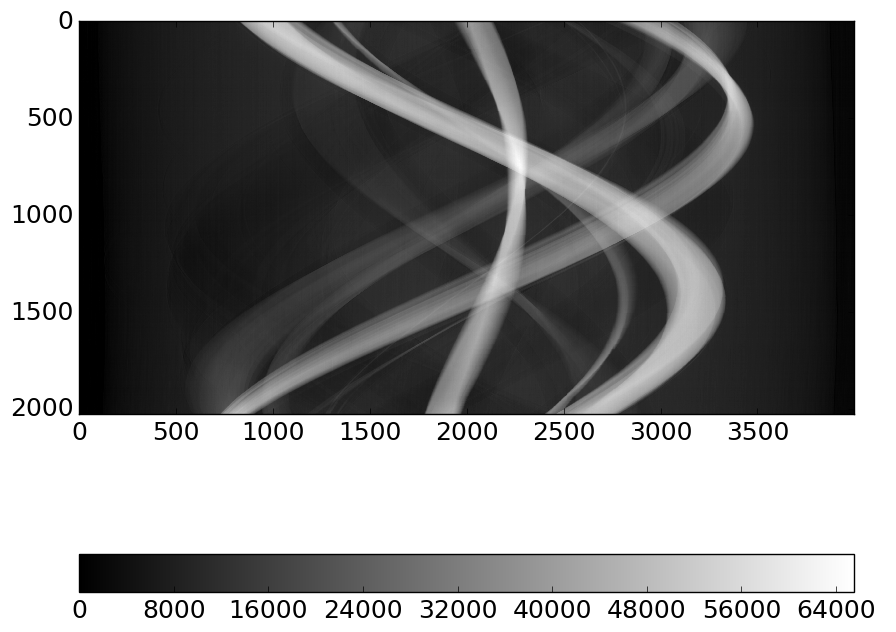

In [17]:
plt.figure(figsize=(10,12))
plt.imshow(sinogram0, cmap=plt.cm.gray)
plt.colorbar(orientation='horizontal')

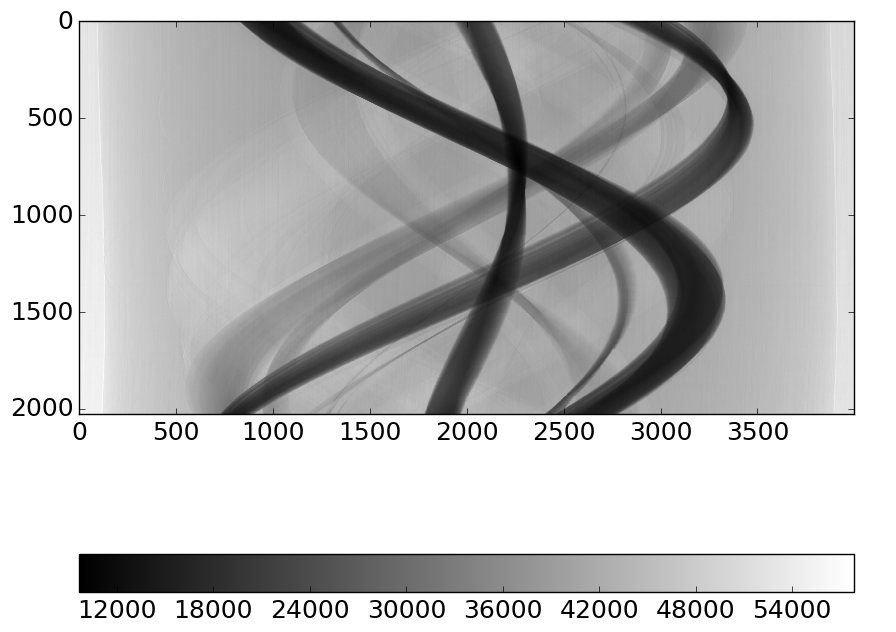

In [18]:
plt.figure(figsize=(10,12))
plt.imshow(sinraw0, cmap=plt.cm.gray)
plt.colorbar(orientation='horizontal')

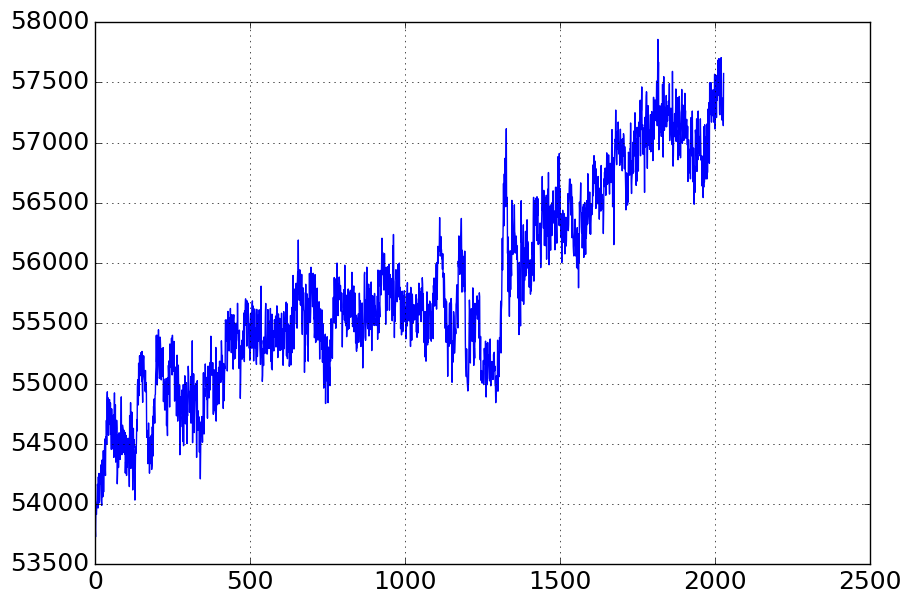

In [19]:
plt.figure(figsize=(10,7))
plt.plot(sinraw0.max(axis=-1))
plt.grid(True)

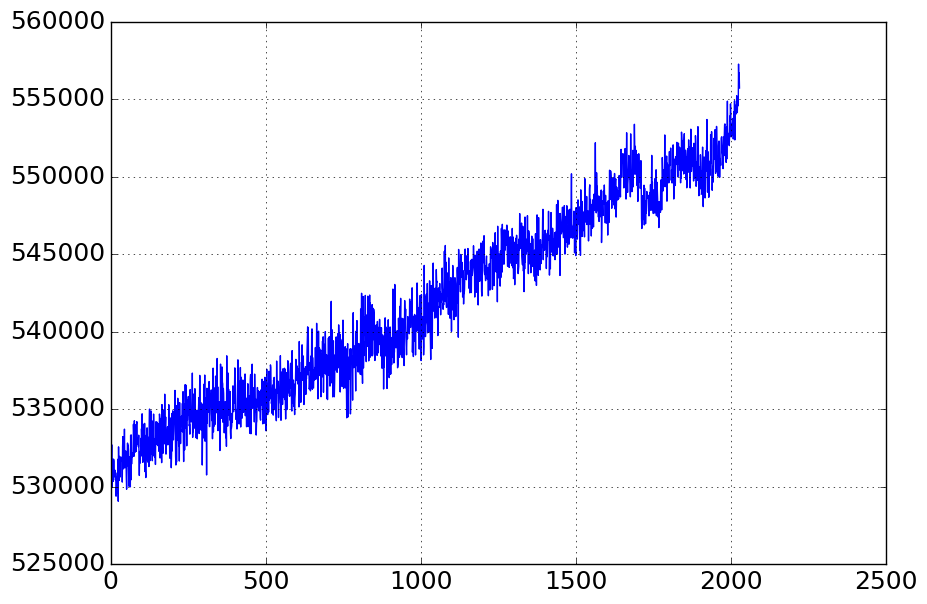

In [20]:
plt.figure(figsize=(10,7))
plt.plot(sinraw0[:,0:10].sum(axis=-1))
plt.grid(True)

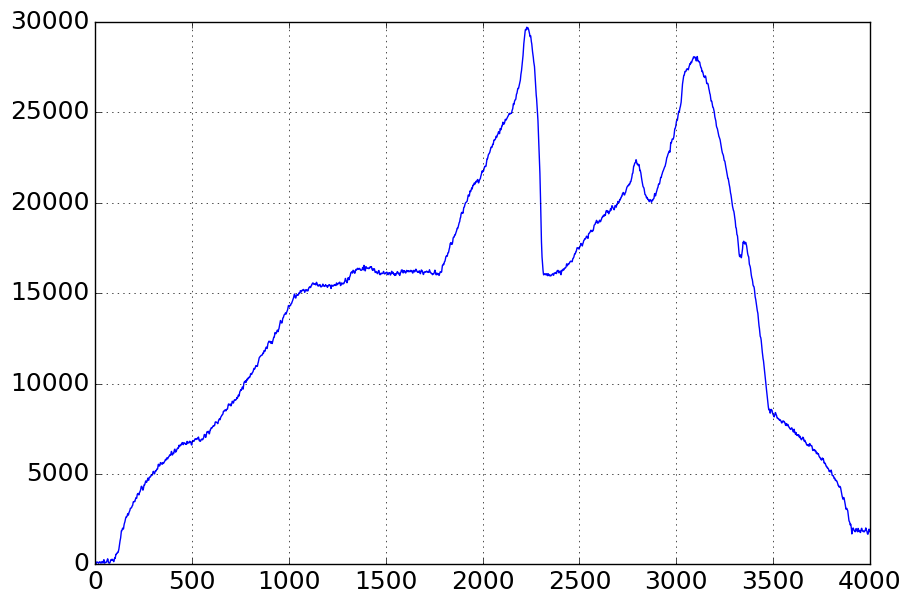

In [24]:
plt.figure(figsize=(10,7))
plt.plot(sinogram0.sum(axis=0)/sinraw0.shape[0])
plt.grid(True)

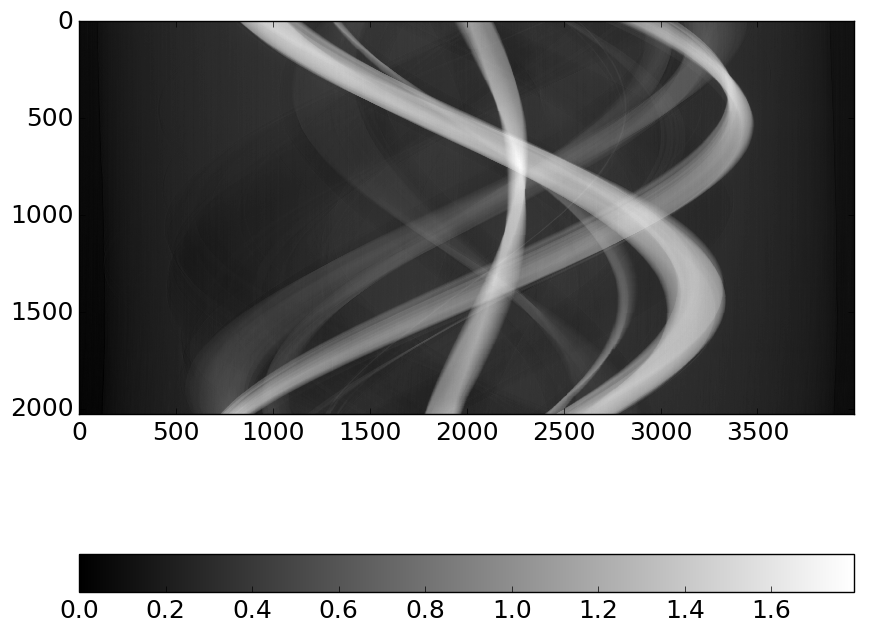

In [21]:
sn0 = -np.log(sinraw0_bh/sinraw0_bh.max())
plt.figure(figsize=(10,12))
plt.imshow(sn0, cmap=plt.cm.gray)
plt.colorbar(orientation='horizontal')

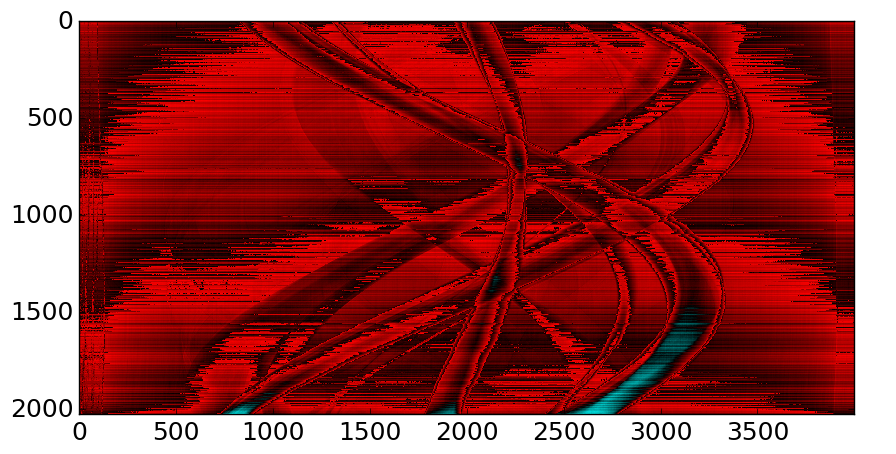

In [22]:
plt.figure(figsize=(10,12))
plt.imshow(100*images_diff(sn0, sinogram0))

In [17]:
def build_reconstruction_geomety(detector_size, angles):
    
    # proj_geom = astra.create_proj_geom('parallel', 1.0, detector_size, angles)
    
    #Object to Source (mm) = 56.135
    #Camera to Source (mm) = 225.082
    
    # All distances in [pixels]
    pixel_size = 2.82473e-3
    os_distance = (56.135)/pixel_size
    ds_distance = (225.082)/pixel_size
    
    proj_geom = astra.create_proj_geom('fanflat', ds_distance/os_distance, detector_size, angles,
                                       os_distance, (ds_distance-os_distance))
#     proj_geom = astra.create_proj_geom('parallel', 1, detector_size, angles)
    
    return proj_geom

def astra_tomo2d_fanflat_fbp(sinogram, angles):
    detector_size = sinogram.shape[1]
    

    rec_size = detector_size # size of reconstruction region
    vol_geom = astra.create_vol_geom(rec_size, rec_size)

    proj_geom = build_reconstruction_geomety(detector_size, angles)
    
    sinogram_id = astra.data2d.create('-sino', proj_geom, data=sinogram)
    # Create a data object for the reconstruction
    rec_id = astra.data2d.create('-vol', vol_geom)

    # Set up the parameters for a reconstruction algorithm using the GPU
    cfg = astra.astra_dict('FBP_CUDA')
    cfg['ReconstructionDataId'] = rec_id
    cfg['ProjectionDataId'] = sinogram_id
    cfg['option'] = {}
    cfg['option']['ShortScan'] = True
#     cfg['option']['MinConstraint'] = 0
    # cfg['option']['MaxConstraint'] = 5

    # Available algorithms:
    # SIRT_CUDA, SART_CUDA, EM_CUDA, FBP_CUDA (see the FBP sample)

    # Create the algorithm object from the configuration structure
    alg_id = astra.algorithm.create(cfg)

    # Run 150 iterations of the algorithm
    astra.algorithm.run(alg_id,  1)

    # Get the result
    rec = astra.data2d.get(rec_id)
    # Clean up. Note that GPU memory is tied up in the algorithm object,
    # and main RAM in the data objects.
    astra.algorithm.delete(alg_id)
    astra.data2d.delete(rec_id)
    astra.data2d.delete(sinogram_id)
    astra.clear()
    return rec, proj_geom, cfg

def get_reconstruction(sinogram, reconstruction_function, min_level=None):
    angles = np.arange(sinogram.shape[0])*0.1#-11.493867*2
    angles = angles/180.*np.pi
#     angles = angles-(angles.max()-angles.min())/2
    if min_level is None:
        astra_rec, proj_geom, cfg = reconstruction_function(np.flipud(sinogram), angles)
    else:
        astra_rec, proj_geom, cfg= reconstruction_function(np.flipud(sinogram), angles, min_level)

    astra_rec = np.flipud(astra_rec)
    return astra_rec

def get_reconstruction_fbp(sinogram):
    return get_reconstruction(sinogram, astra_tomo2d_fanflat_fbp)

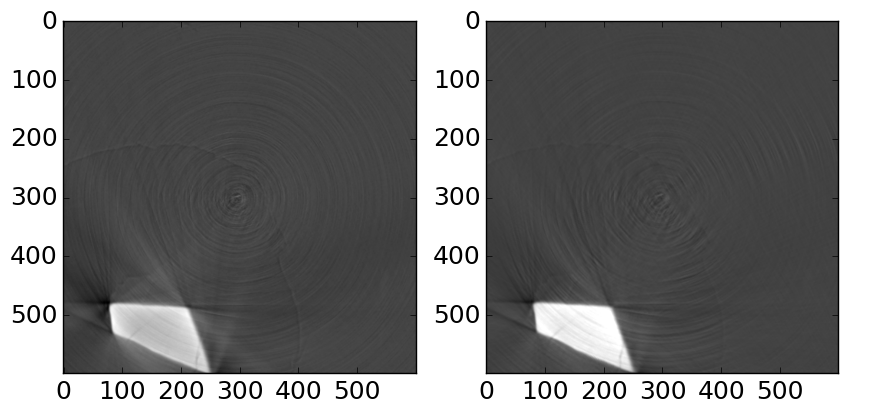

In [26]:
r=get_reconstruction_fbp(sn0)
plt.figure(figsize=(10,15))
plt.subplot(121)
plt.imshow(r[1700:2300,1700:2300], cmap=plt.cm.gray)
plt.subplot(122)
plt.imshow(rec0_bh[1700:2300,1700:2300], cmap=plt.cm.gray)

In [26]:
from scipy.ndimage import median_filter, gaussian_filter
from scipy.signal import medfilt

In [21]:
from collections import OrderedDict
recs = OrderedDict()
recs['0']=rec0
recs['5']=rec5
recs['10']=rec10
recs['15']=rec15
recs['20']=rec20

In [22]:
from scipy.ndimage import median_filter
def remove_stripes(sinogram, level):
    """
    Sinogram - 2D sinogram (slice)
    Level - Nrecon correction level
    """
    if level==0:
        return sinogram
    else:
        return median_filter(sinogram,[1,level+9])

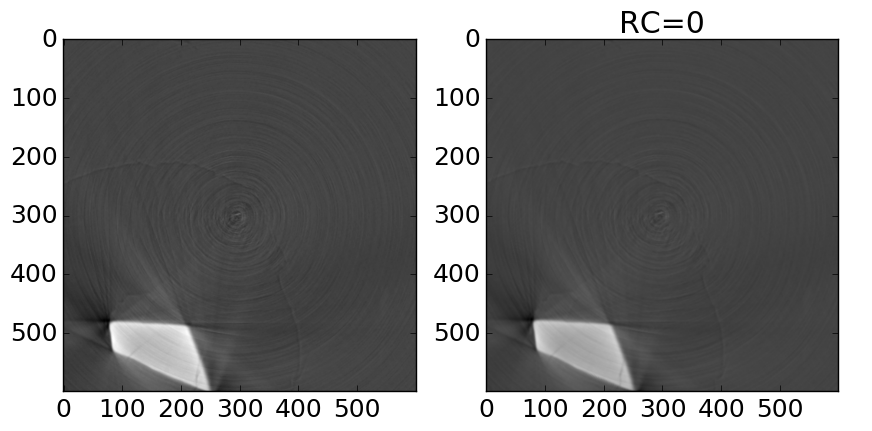

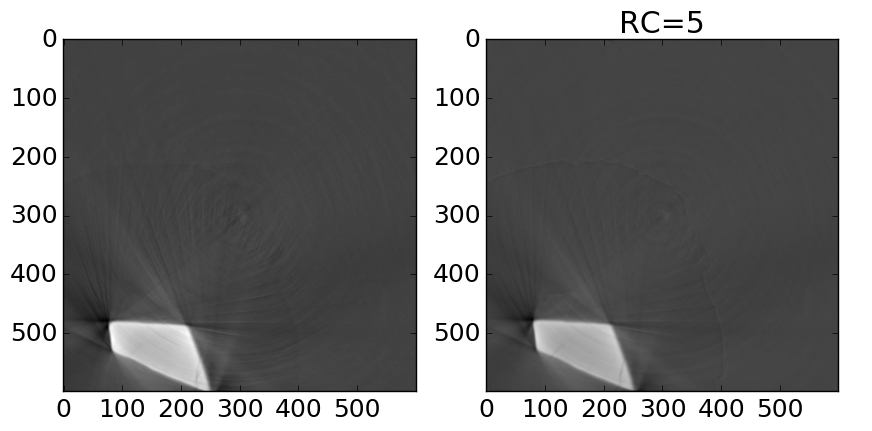

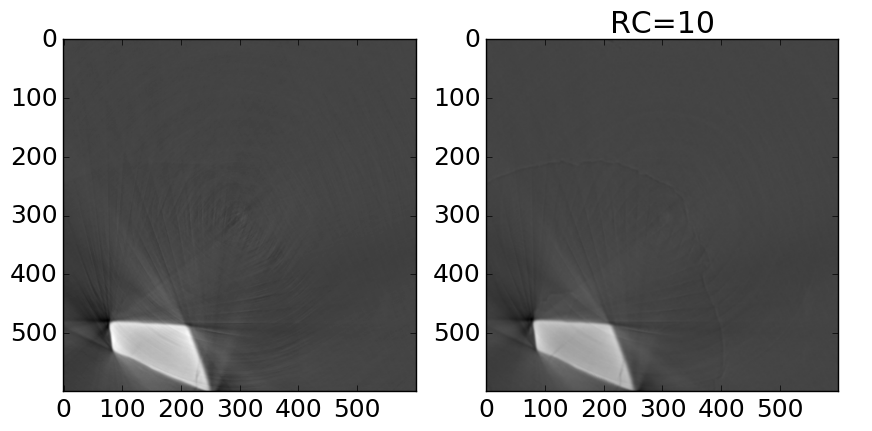

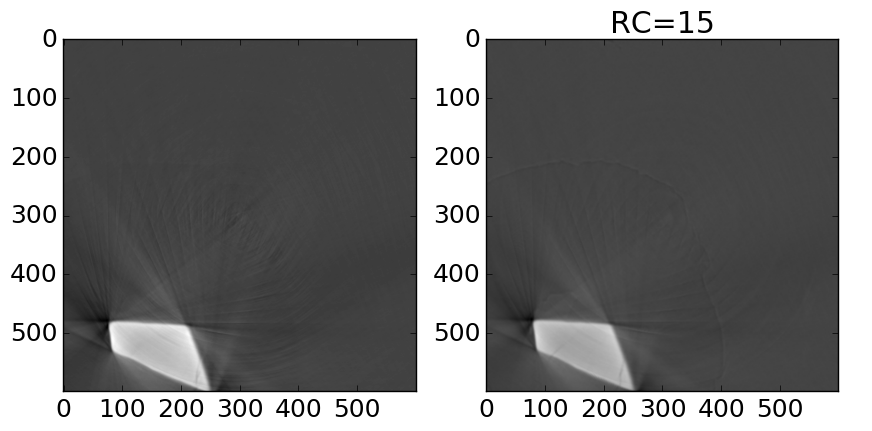

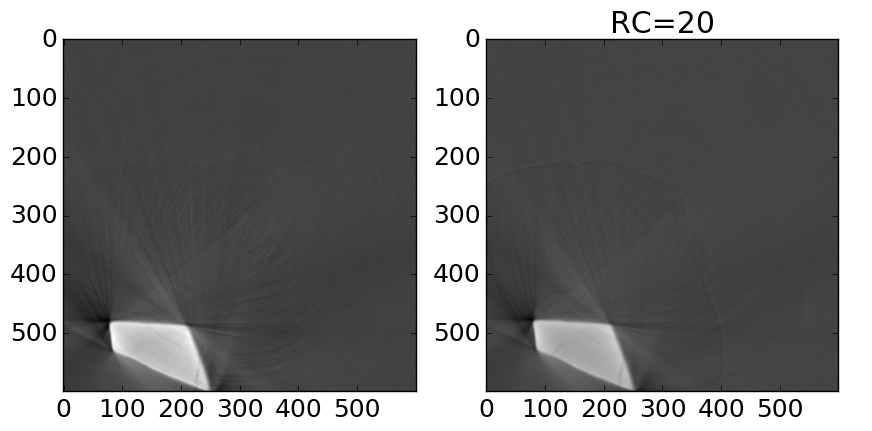

In [25]:
for l in range(0,21,5):
    sn1 = remove_stripes(sn0,l)
    
    r=get_reconstruction_fbp(sn1)
    plt.figure(figsize=(10,15))
    plt.subplot(121)
    plt.imshow(r[1700:2300,1700:2300], cmap=plt.cm.gray)
    plt.subplot(122)
    plt.imshow(recs[str(l)][1700:2300,1700:2300], cmap=plt.cm.gray)
    plt.title('RC='+str(l))
    plt.show()

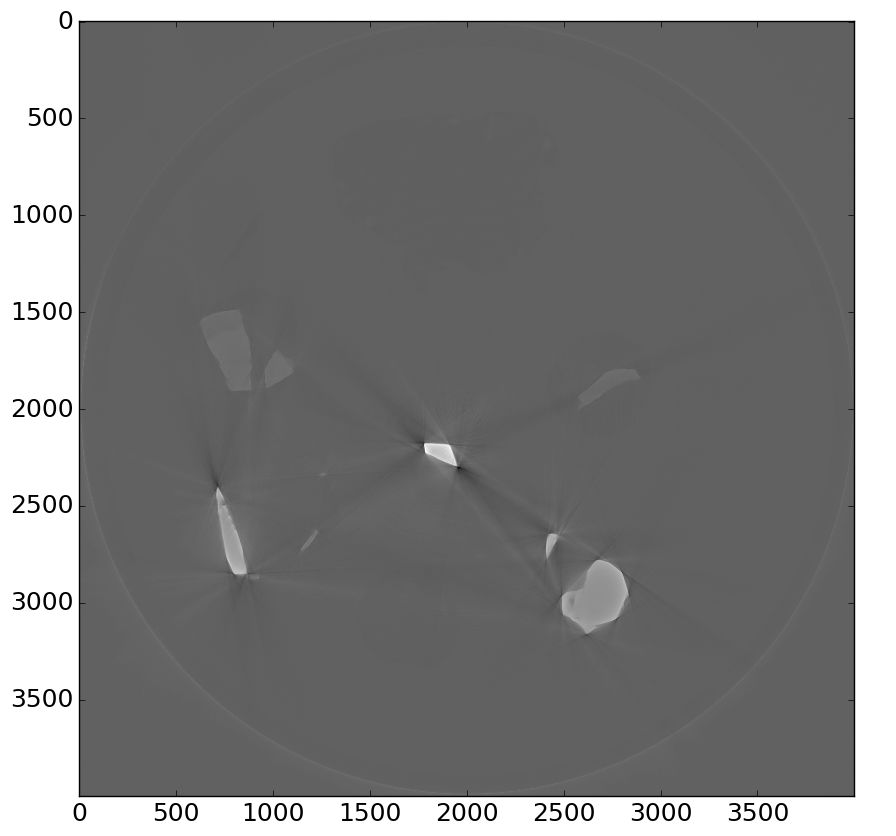

In [26]:
plt.figure(figsize=(10,15))
plt.imshow(r, cmap=plt.cm.gray)
plt.show()

In [57]:
r0=recs['0']
for k,v in recs.iteritems():
    t = np.gradient(v-r0)
    r = (t[0]**2+t[1]**2)
    print(k,np.sum(np.isclose(r,0)))

('0', 48000000)
('5', 23267139)
('10', 22964544)
('15', 22927311)
('20', 22890924)


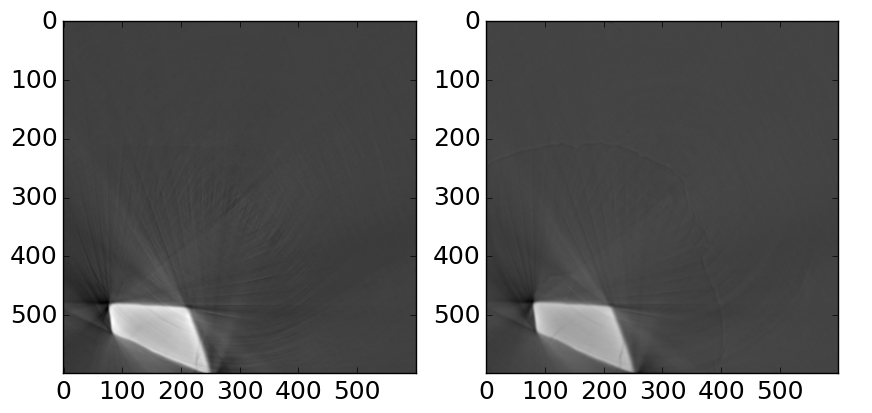

In [173]:
sn1 = median_filter(sn0,[1,30])
r=get_reconstruction_fbp(sn1)
plt.figure(figsize=(10,15))
plt.subplot(121)
plt.imshow(r[1700:2300,1700:2300], cmap=plt.cm.gray)
plt.subplot(122)
plt.imshow(rec20[1700:2300,1700:2300], cmap=plt.cm.gray)

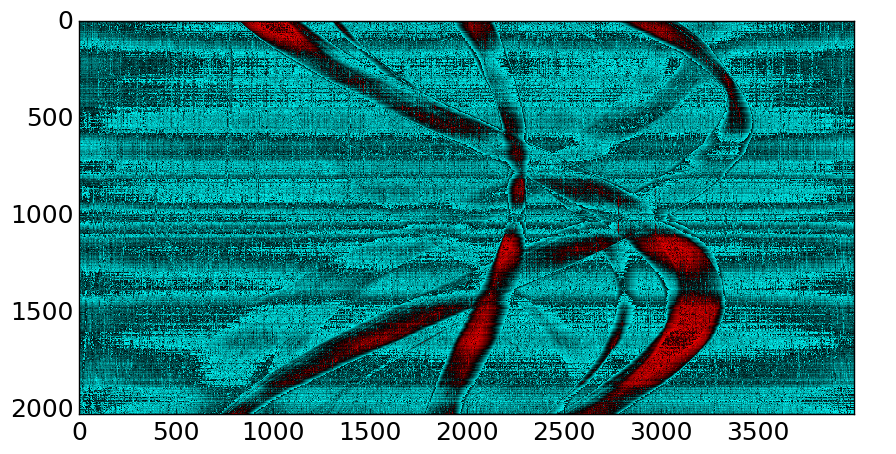

In [164]:
plt.figure(figsize=(10,12))
plt.imshow(100*images_diff(sinogram0,sn1))

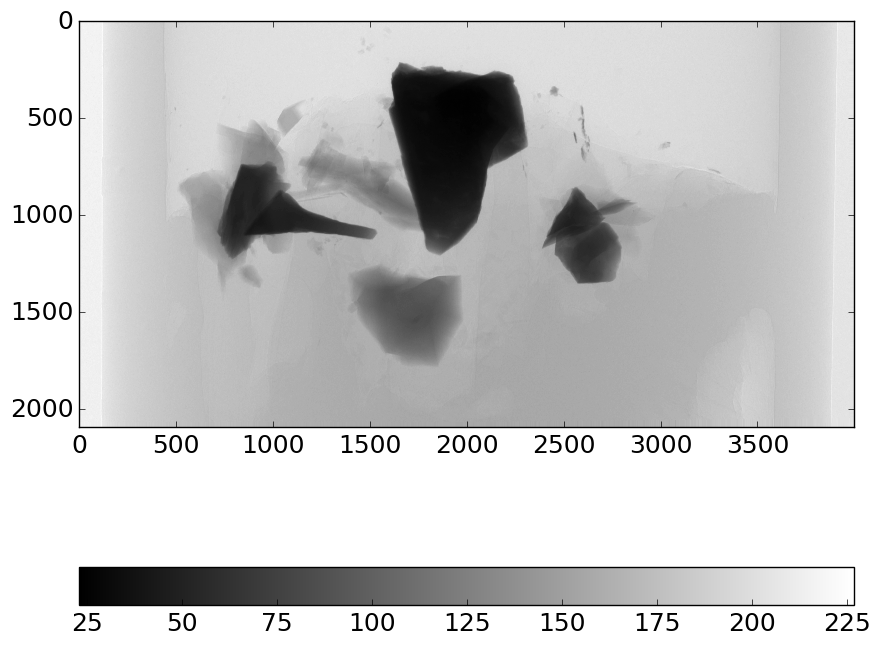

In [109]:
plt.figure(figsize=(10,12))
plt.imshow(plt.imread(
        '/diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__rec_spr.bmp'),
           cmap=plt.cm.gray)
plt.colorbar(orientation='horizontal')

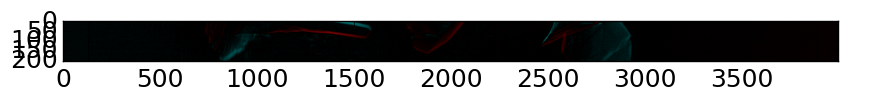

In [120]:
pp1 = plt.imread(
            '/diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__pp1.tif').astype('float32')
pp2 = plt.imread(
            '/diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__pp2.tif').astype('float32')
plt.figure(figsize=(10,12))
plt.imshow(images_diff(pp1, np.fliplr(pp2)))
# plt.colorbar(orientation='horizontal')

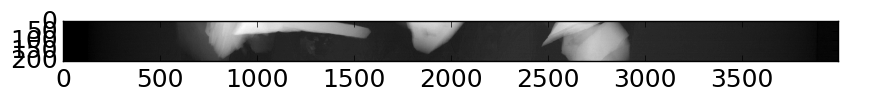

In [114]:
plt.figure(figsize=(10,12))
plt.imshow(plt.imread(
            '/diskmnt/a/makov/yaivan/MMC_1/_tmp/nrecon/bh_0_rc_20/MMC1_2.82um__pp1.tif'),
           cmap=plt.cm.gray)

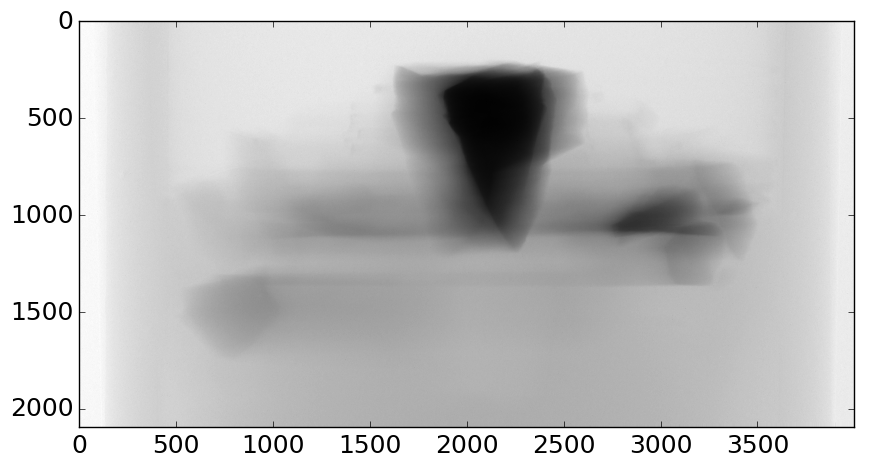

In [29]:
arc = pp1 = plt.imread(
            '/diskmnt/a/makov/yaivan/MMC_1/Raw/MMC1_2.82um__arc.tif').astype('float32')
plt.figure(figsize=(10,12))
plt.imshow(arc,cmap=plt.cm.gray)

# Радоновский инвариант

In [23]:
from collections import OrderedDict
sinograms = OrderedDict()
sinograms['0']=sinogram0
sinograms['5']=sinogram5
sinograms['10']=sinogram10
sinograms['15']=sinogram15
sinograms['20']=sinogram20

/home/makov/opt/anaconda/envs/astra-dbg/lib/python2.7/site-packages/matplotlib/cbook.py:137: MatplotlibDeprecationWarning: The set_color_cycle attribute was deprecated in version 1.5. Use set_prop_cycle instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


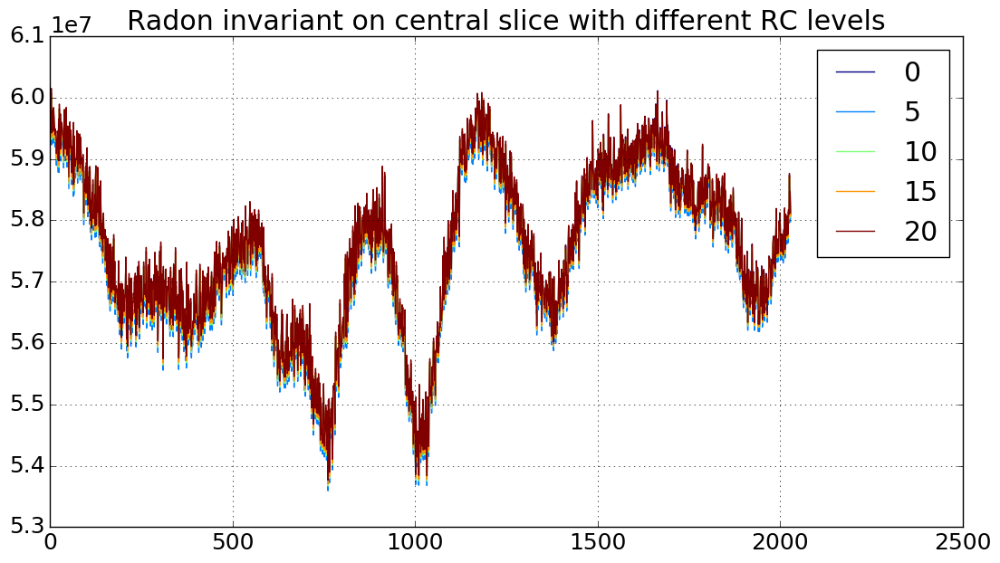

In [19]:
plt.figure(figsize=(13,7))
colormap = plt.cm.jet
plt.gca().set_color_cycle([colormap(k) for k in np.linspace(0, 1, len(sinograms))])
for k,v in sinograms.iteritems():
    plt.plot(v.sum(axis=-1), label=k)
    plt.hold(True)

plt.legend(loc=0)
plt.grid(True)
plt.title('Radon invariant on central slice with different RC levels')
plt.show()

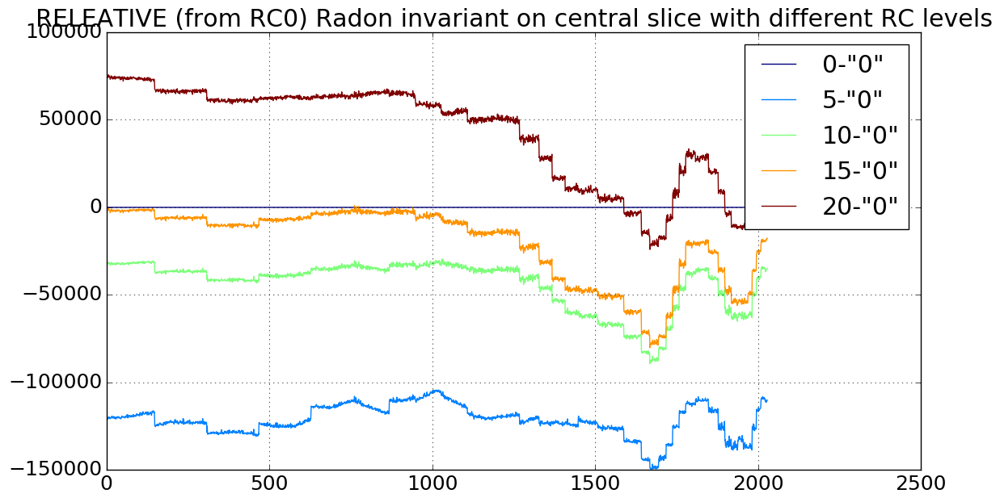

In [20]:
s0 = sinograms['0']
plt.figure(figsize=(13,7))
colormap = plt.cm.jet
plt.gca().set_color_cycle([colormap(k) for k in np.linspace(0, 1, len(sinograms))])
for k,v in sinograms.iteritems():
    plt.plot((v-s0).sum(axis=-1), label=k+'-"0"')
    plt.hold(True)

plt.legend(loc=0)
plt.grid(True)
plt.title('RELEATIVE (from RC0) Radon invariant on central slice with different RC levels')
plt.show()

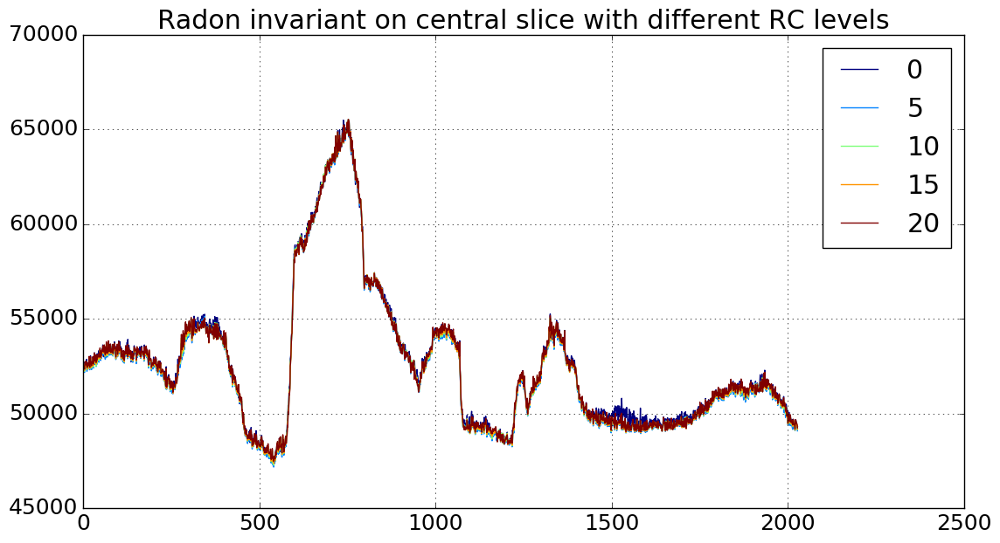

In [21]:
plt.figure(figsize=(13,7))
colormap = plt.cm.jet
plt.gca().set_color_cycle([colormap(k) for k in np.linspace(0, 1, len(sinograms))])
for k,v in sinograms.iteritems():
    plt.plot(v.max(axis=-1), label=k)
    plt.hold(True)

plt.legend(loc=0)
plt.grid(True)
plt.title('Radon invariant on central slice with different RC levels')
plt.show()

In [19]:
tmp_dir = '/diskmnt/fast/makov/tmp/'
images_ext = 'tif'
data_tmp_file = os.path.join(tmp_dir,'images.{}.tmp'.format(images_ext))
data_tmp_size_file = os.path.join(tmp_dir,'images.{}.size.txt'.format(images_ext))
if os.path.exists(data_tmp_file) and os.path.exists(data_tmp_size_file):
    print('File {} found, read it. Not load original images'.format(data_tmp_file))
    data_blob = np.memmap(data_tmp_file,
                  dtype='uint16',
                  shape=tuple(np.loadtxt(data_tmp_size_file).astype('uint16')),
                  mode='r'
                 )
else:
    raise(ValueError)


File /diskmnt/fast/makov/tmp/images.tif.tmp found, read it. Not load original images


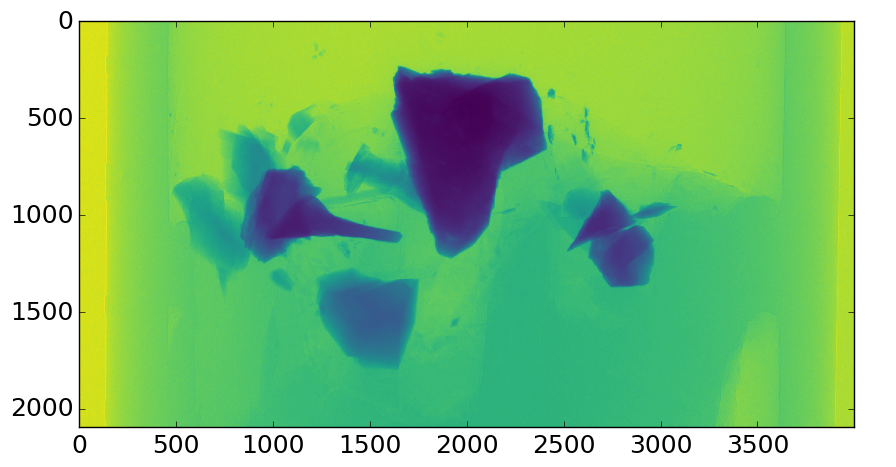

In [26]:
plt.figure(figsize=(10,15))
plt.imshow(data_blob[100,:,:].astype('float32'), interpolation='nearest', cmap=plt.cm.viridis)

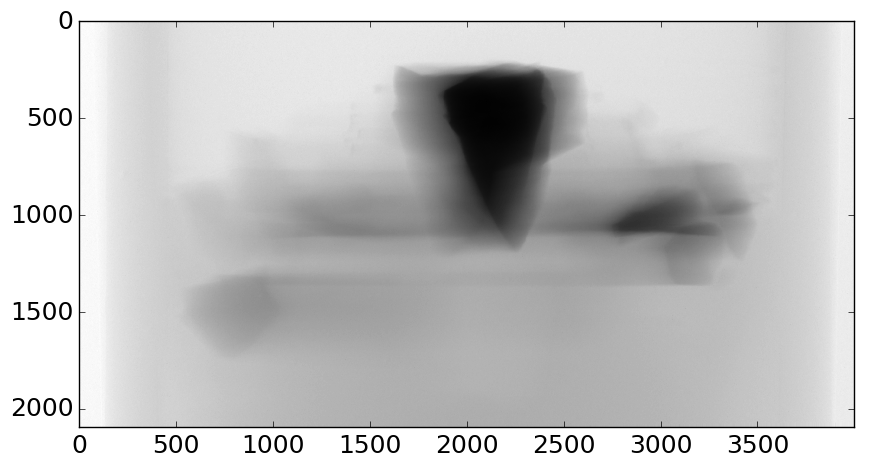

In [20]:
my_arc = np.zeros((data_blob.shape[1],data_blob.shape[2]),dtype='float32')
for sss in log_progress(range(data_blob.shape[0])):
    my_arc+=data_blob[sss]
plt.figure(figsize=(10,15))
plt.imshow(my_arc, interpolation='nearest', cmap=plt.cm.gray)

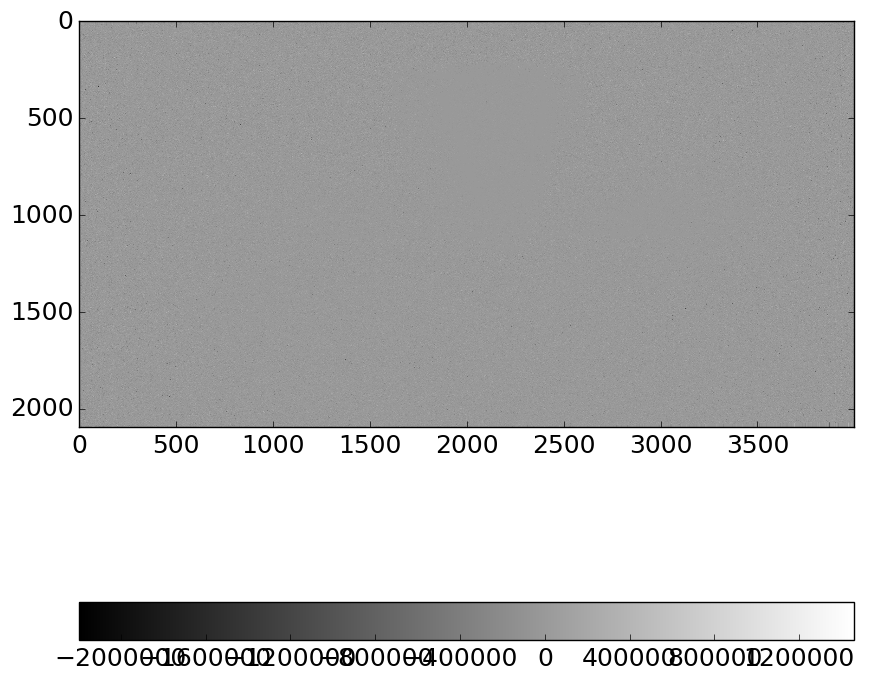

In [29]:
plt.figure(figsize=(10,15))
plt.imshow(my_arc-median_filter(my_arc,3),cmap=plt.cm.gray)
plt.colorbar(orientation='horizontal')

In [23]:
s_max=[]
s_min=[]
for i in log_progress(range(data_blob.shape[0])):
    s_max.append(data_blob[i].max())
    s_min.append(data_blob[i].min())

Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"


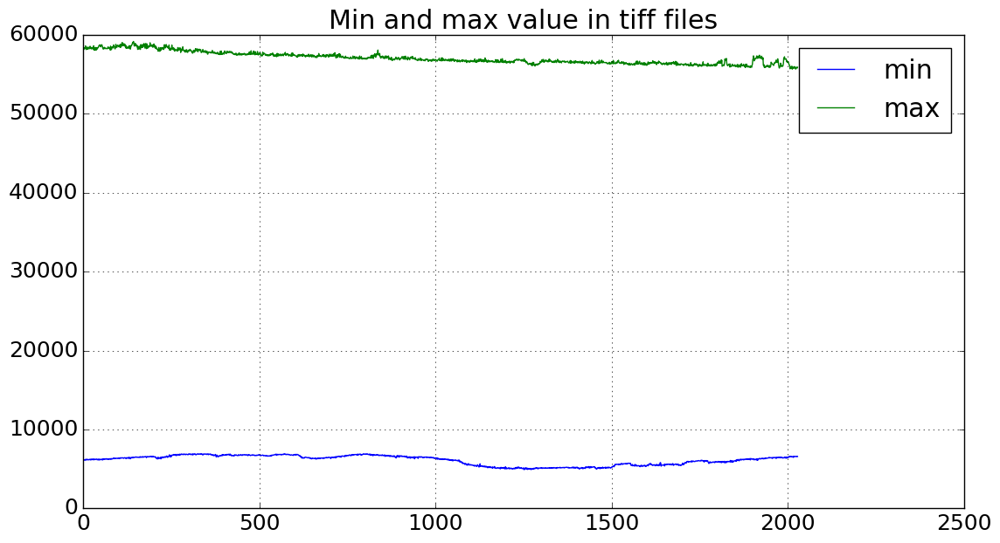

In [24]:
plt.figure(figsize=(13,7))
plt.plot(s_min, label='min')
plt.plot(s_max, label='max')
plt.legend(loc=0)
plt.grid(True)
plt.title('Min and max value in tiff files')
plt.show()

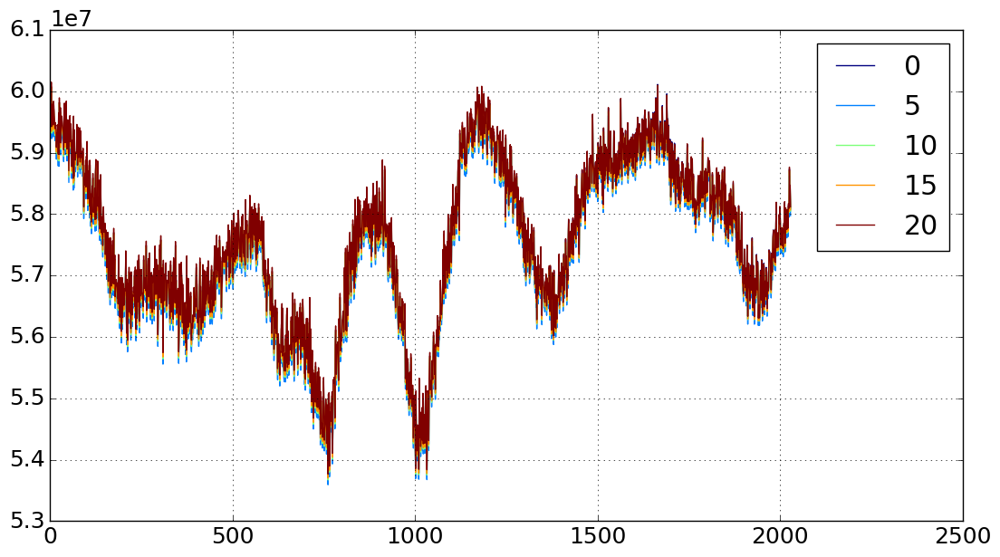

In [25]:
from collections import OrderedDict
sinograms = OrderedDict()
sinograms['0']=sinogram0
sinograms['5']=sinogram5
sinograms['10']=sinogram10
sinograms['15']=sinogram15
sinograms['20']=sinogram20

plt.figure(figsize=(13,7))
colormap = plt.cm.jet
plt.gca().set_color_cycle([colormap(k) for k in np.linspace(0, 1, len(sinograms))])
for k,v in sinograms.iteritems():
    plt.plot(v.sum(axis=-1), label=k)
    plt.hold(True)

plt.legend(loc=0)
plt.grid(True)
plt.show()

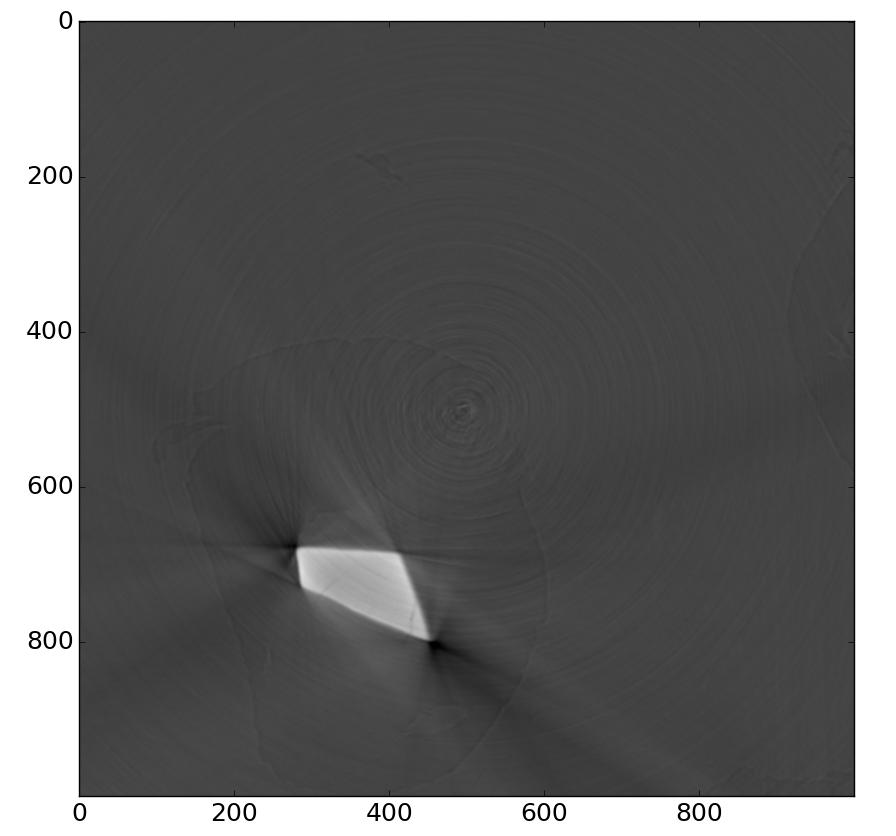

In [27]:
plt.figure(figsize=(10,12))
plt.imshow(rec0[1500:2500,1500:2500])

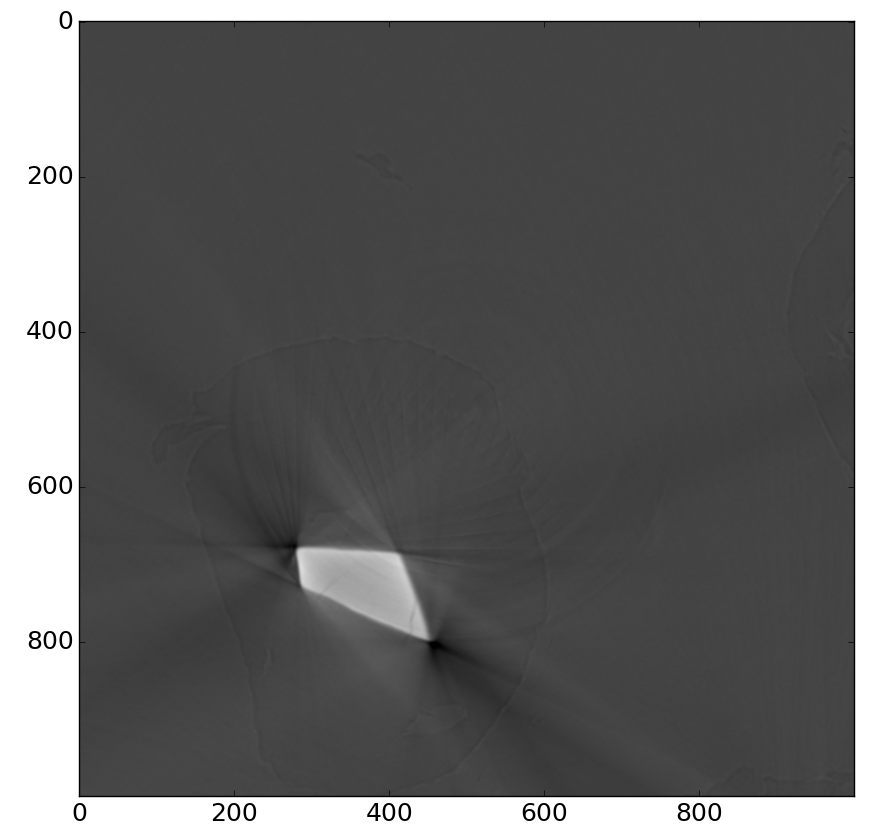

In [28]:
plt.figure(figsize=(10,12))
plt.imshow(rec20[1500:2500,1500:2500])

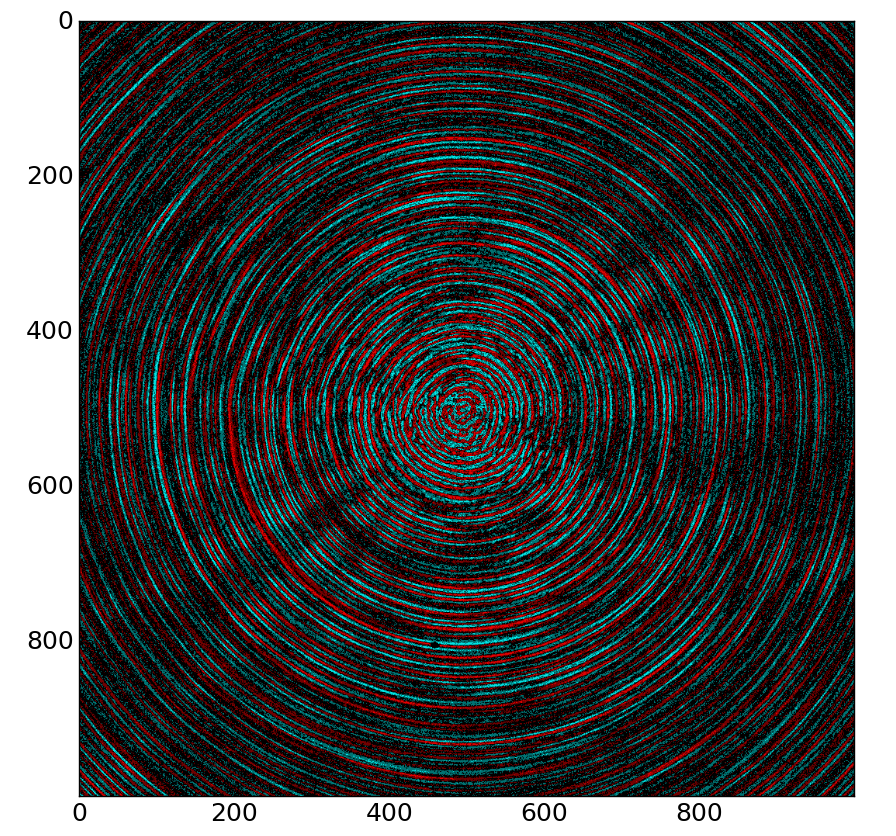

In [29]:
plt.figure(figsize=(10,12))
plt.imshow(100*images_diff(rec0[1500:2500,1500:2500,0],rec5[1500:2500,1500:2500,0]))

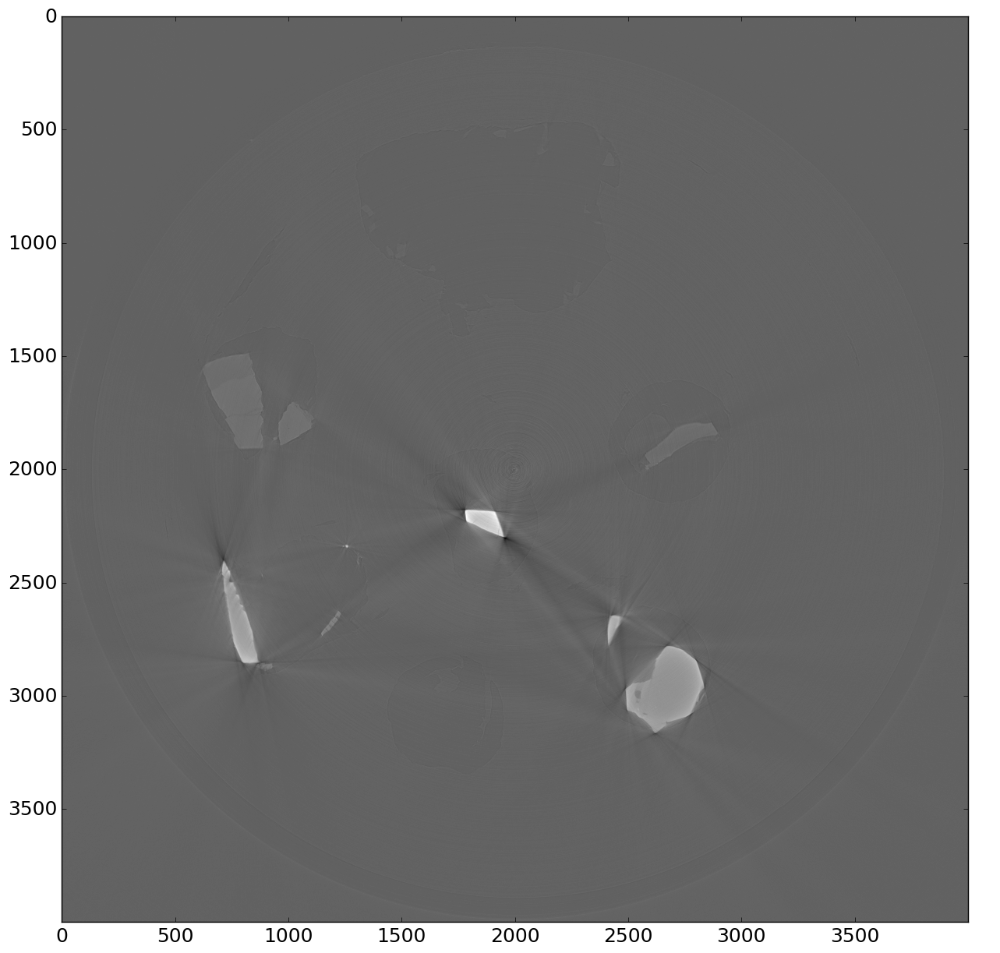

In [31]:
r=get_reconstruction_fbp(sinogram0)
plt.figure(figsize=(15,15))
plt.imshow(r, cmap=plt.cm.gray)
# plt.colorbar(orientation='horizontal')

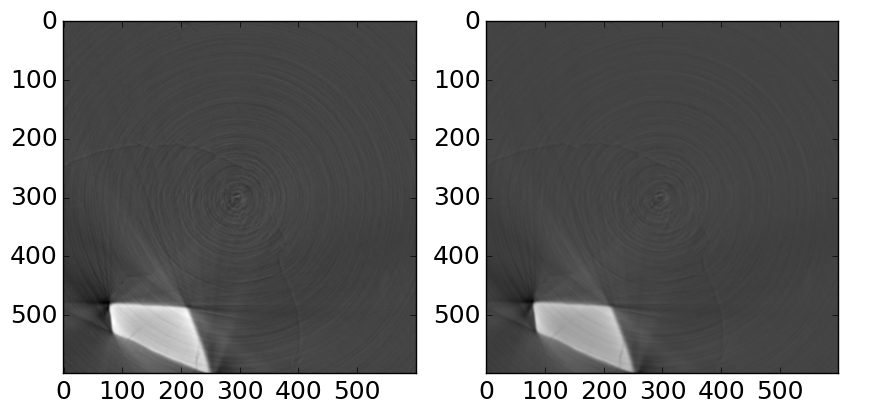

In [32]:
plt.figure(figsize=(10,15))
plt.subplot(121)
plt.imshow(r[1700:2300,1700:2300], cmap=plt.cm.gray)
plt.subplot(122)
plt.imshow(rec0[1700:2300,1700:2300], cmap=plt.cm.gray)

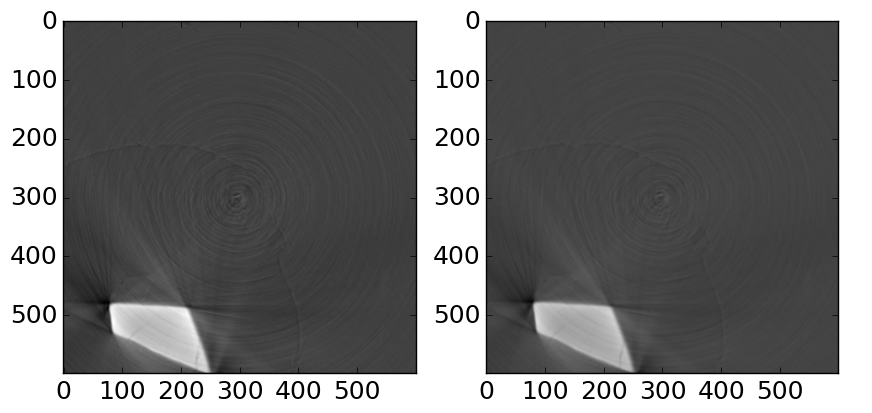

In [33]:
s1 = sinogram0.T/sinogram0.sum(axis=-1)
r=get_reconstruction_fbp(s1.T)
plt.figure(figsize=(10,15))
plt.subplot(121)
plt.imshow(r[1700:2300,1700:2300], cmap=plt.cm.gray)
plt.subplot(122)
plt.imshow(rec0[1700:2300,1700:2300], cmap=plt.cm.gray)

In [34]:
import tomopy

In [99]:
st1 = np.expand_dims(sinogram0,-1)
st1 = tomopy.prep.stripe.remove_stripe_fw(st1, level=40)
st1=np.squeeze(st1)

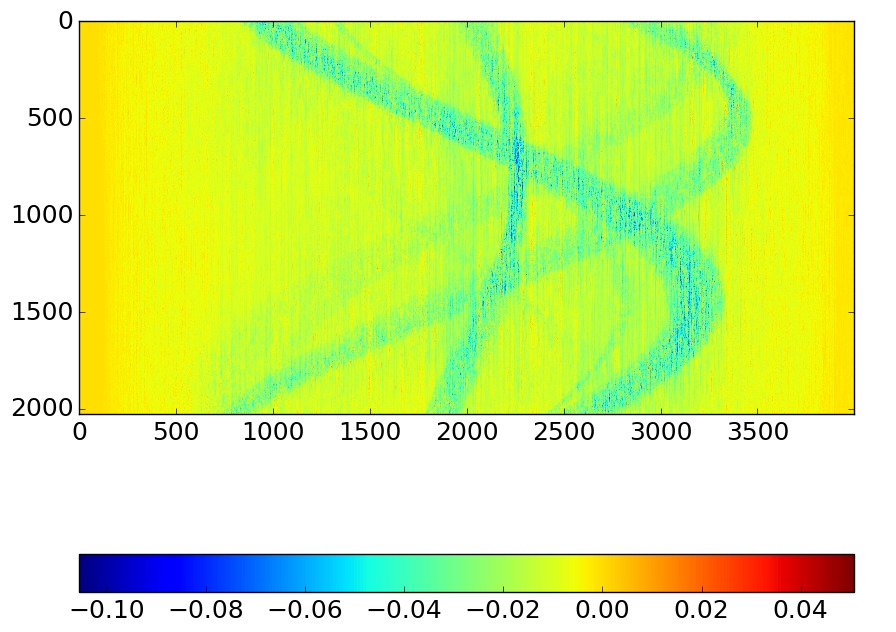

In [92]:
plt.figure(figsize=(10,12))
plt.imshow(sinogram0-st1)
plt.colorbar(orientation='horizontal')

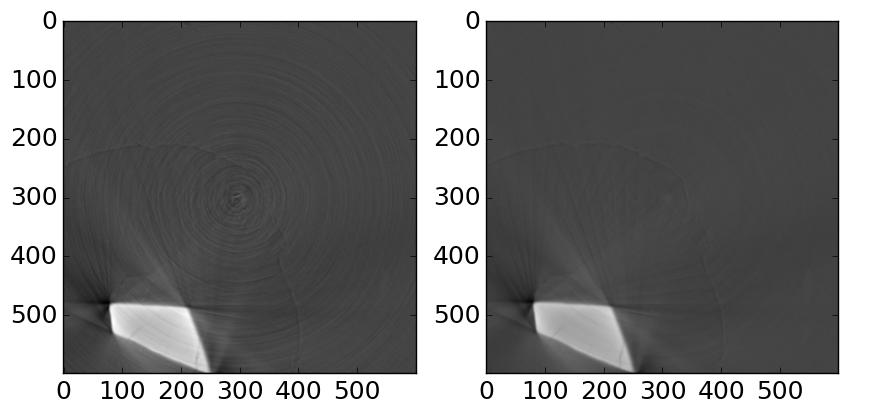

In [98]:
r=get_reconstruction_fbp(st1)
plt.figure(figsize=(10,15))
plt.subplot(121)
plt.imshow(r[1700:2300,1700:2300], cmap=plt.cm.gray)
plt.subplot(122)
plt.imshow(rec10[1700:2300,1700:2300], cmap=plt.cm.gray)

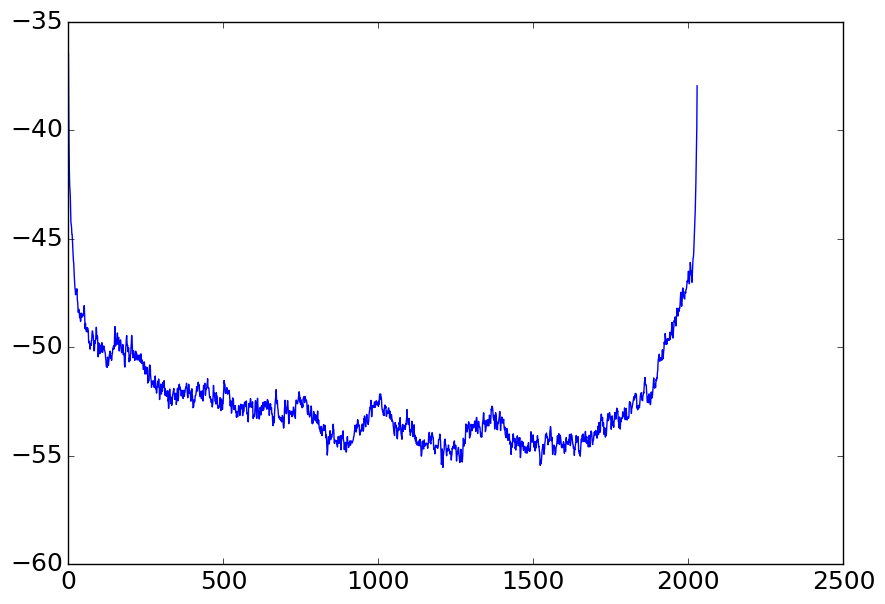

In [94]:
plt.figure(figsize=(10,7))
plt.plot((sinogram0-st1).sum(axis=-1))

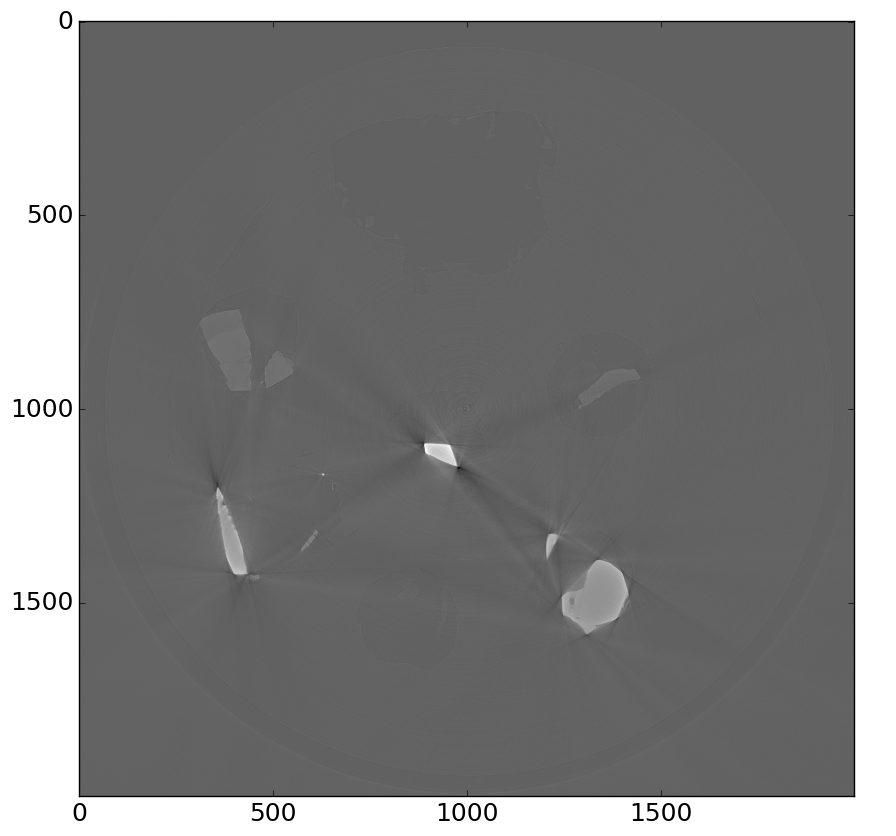

In [72]:
plt.figure(figsize=(10,15))
plt.imshow(r[::2,::2], cmap=plt.cm.gray)

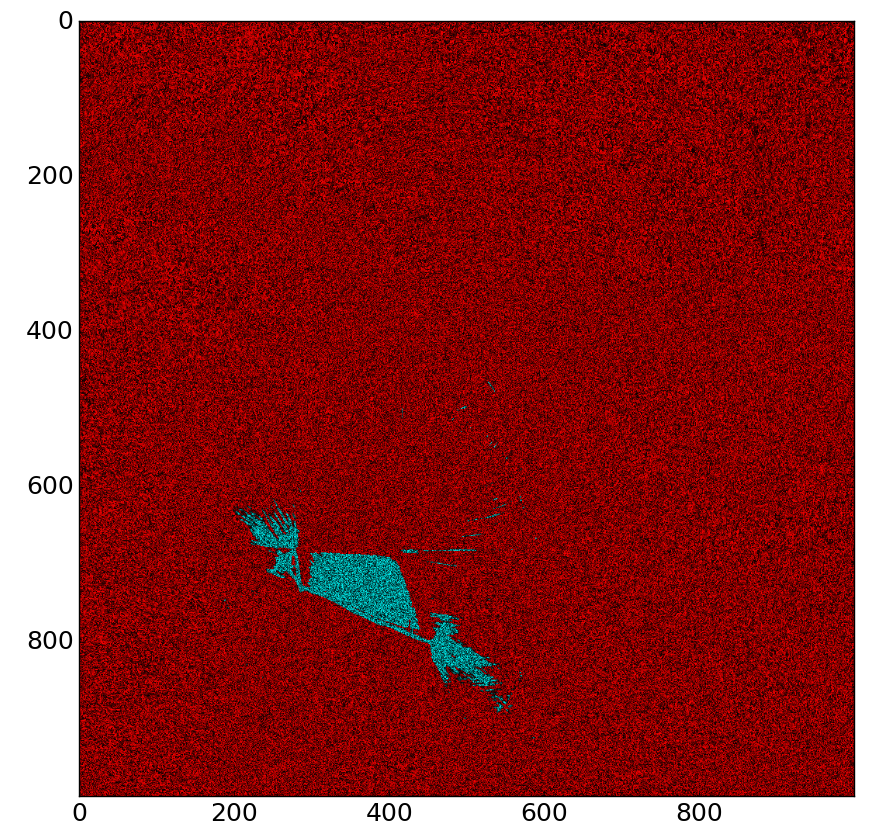

In [34]:
plt.figure(figsize=(10,12))
plt.imshow(100*images_diff(rec0[1500:2500,1500:2500,0],r[1500:2500,1500:2500]))

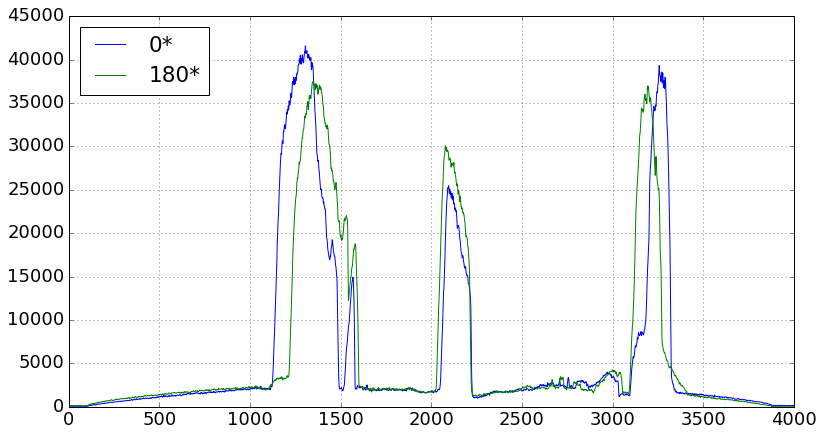

In [193]:
plt.figure(figsize=(13,7))
# plt.plot(sinogram10.max(axis=0), label='Max')
plt.hold(True)
# plt.plot(sinogram10.min(axis=0), label='Min')
# plt.plot(sinogram10.mean(axis=0), label='Mean')
# plt.plot(sinogram10[0], label='0')
# plt.plot(sinogram10[1800,::-1], label='180')
plt.plot(sinogram10[sinogram10.shape[0]-1800], label='0*')
plt.plot(sinogram10[-1,::-1], label='180*')

plt.legend(loc=0)
plt.grid(True)
plt.show()

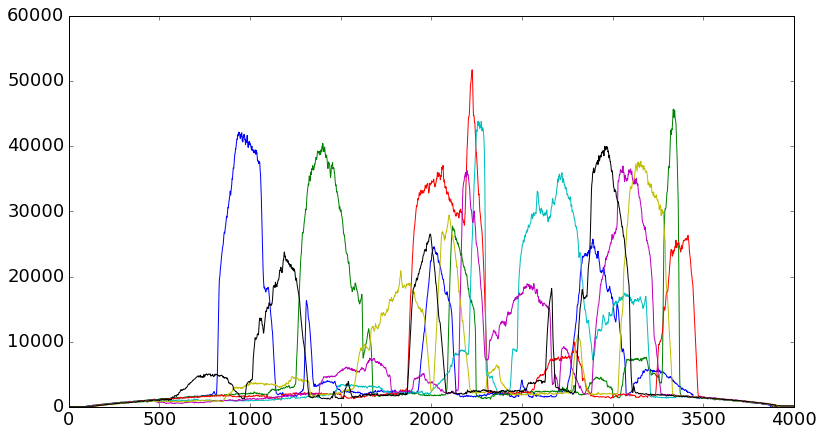

In [188]:
plt.figure(figsize=(13,7))
plt.plot(sinogram10[::300].T);

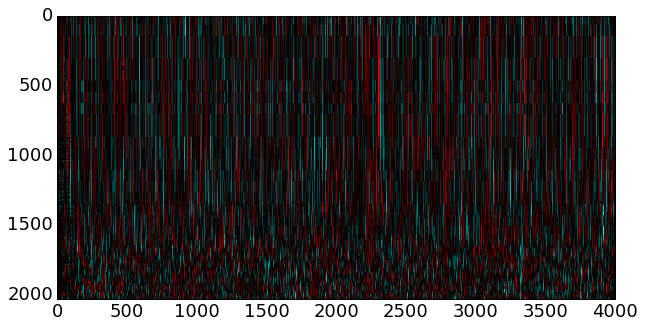

In [18]:
plt.figure(figsize=(10,12))
plt.imshow(100*images_diff(sinogram0,sinogram10))
# plt.colorbar(orientation='horizontal')

In [19]:
from scipy.ndimage import median_filter, gaussian_filter
from scipy.signal import medfilt

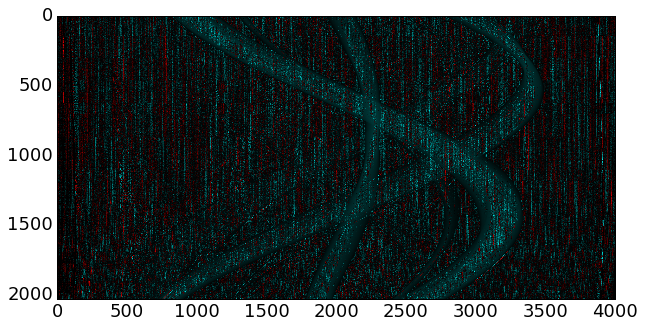

In [62]:
plt.figure(figsize=(10,12))
plt.imshow(100*images_diff(sinogram0,median_filter(sinogram0,[1,7])))

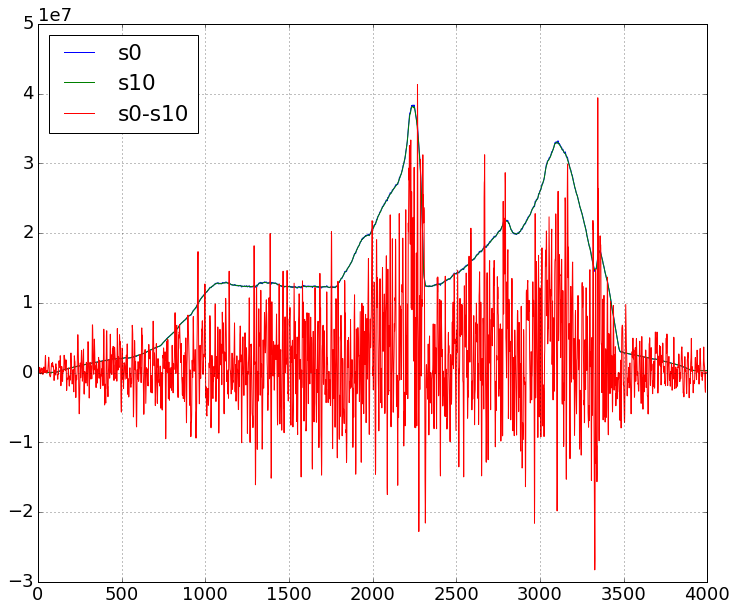

In [155]:
s0=sinogram0.sum(axis=0)
# sf = median_filter(sinogram0,[1,3]).sum(axis=0)
s10=sinogram10.sum(axis=0)
plt.figure(figsize=(12,10))
plt.plot(s0, label='s0')
plt.plot(s10, label='s10')
plt.plot(100*(s0-s10), label='s0-s10')
# plt.plot(100*(sf-s10), label='s0-sf')
plt.grid(True)
plt.legend(loc=0)


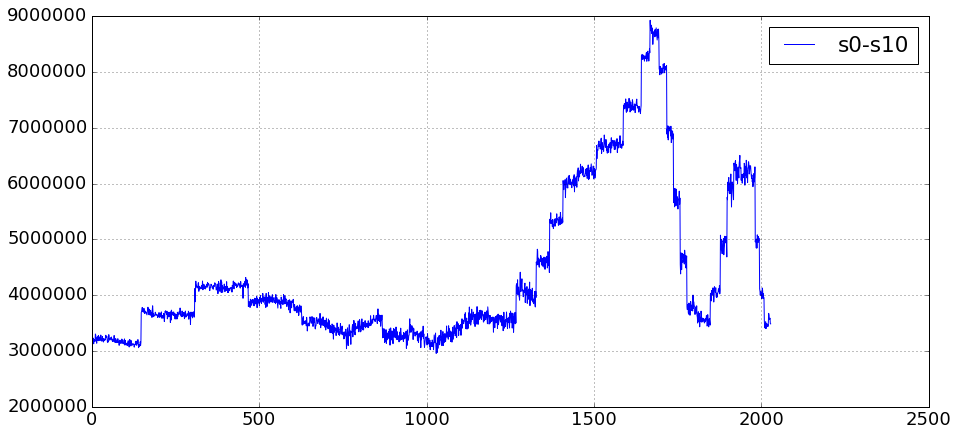

In [34]:
s0=sinogram0.sum(axis=1)
# sf = median_filter(sinogram0,[1,3]).sum(axis=0)
s10=sinogram10.sum(axis=1)
plt.figure(figsize=(15,7))
# plt.plot(s0, label='s0')
# plt.plot(s10, label='s10')
plt.plot(100*(s0-s10), label='s0-s10')
# plt.plot(100*(sf-s10), label='s0-sf')
plt.grid(True)
plt.legend(loc=0)

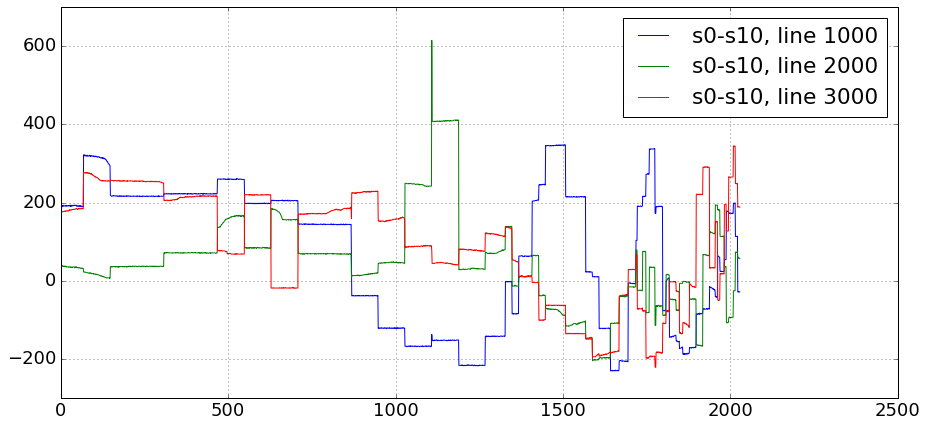

In [39]:
s0=sinogram0
# sf = median_filter(sinogram0,[1,3]).sum(axis=0)
s10=sinogram10
plt.figure(figsize=(15,7))
# plt.plot(s0, label='s0')
# plt.plot(s10, label='s10')
plt.plot((s0[:,1000]-s10[:,1000]), label='s0-s10, line 1000')
plt.plot((s0[:,2000]-s10[:,2000]), label='s0-s10, line 2000')
plt.plot((s0[:,3000]-s10[:,3000]), label='s0-s10, line 3000')
# plt.plot(100*(sf-s10), label='s0-sf')
plt.grid(True)
plt.legend(loc=0)

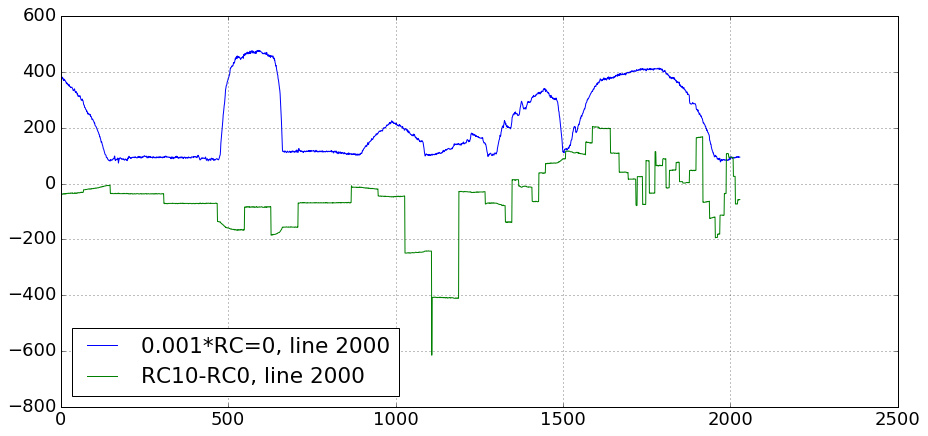

In [22]:
s0=sinogram0
# sf = median_filter(sinogram0,[1,3]).sum(axis=0)
s5=sinogram5
s10=sinogram10
s15=sinogram15
s20 = sinogram20
plt.figure(figsize=(15,7))
# plt.plot(s0, label='s0')
# plt.plot(s10, label='s10')
plt.plot((s0[:,2000]/1e2), label='0.001*RC=0, line 2000')
# plt.plot((s5[:,2000]-s0[:,2000]), label='RC5-RC0, line 2000')
plt.plot((s10[:,2000]-s0[:,2000]), label='RC10-RC0, line 2000')
# plt.plot((s15[:,2000]-s0[:,2000]), label='RC15-RC0, line 2000')
# plt.plot((s20[:,2000]-s0[:,2000]), label='RC20-RC0, line 2000')
# plt.plot((s10[:,2000]-s20[:,2000]), label='s10-s20, line 2000')
# plt.plot((s0[:,3000]-s10[:,3000]), label='s0-s10, line 3000')
# plt.plot(100*(sf-s10), label='s0-sf')
plt.grid(True)
plt.legend(loc=0)

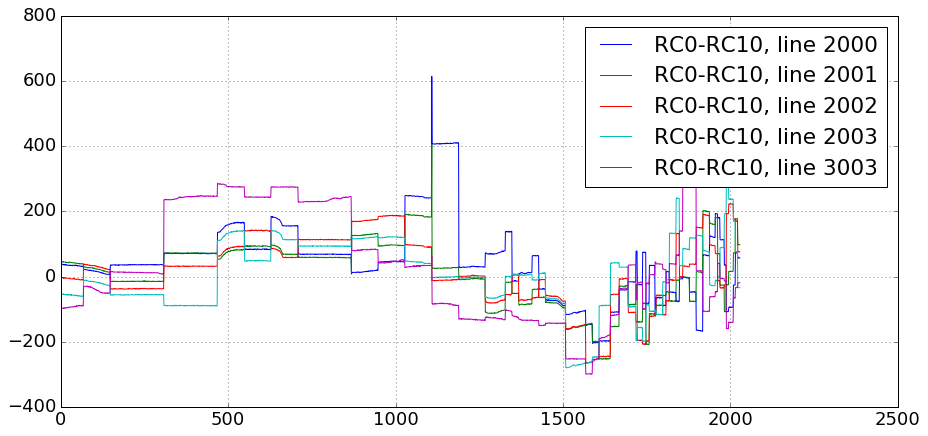

In [54]:
s0=sinogram0
# sf = median_filter(sinogram0,[1,3]).sum(axis=0)
s10=sinogram10
s20 = sinogram20
plt.figure(figsize=(15,7))
# plt.plot(s0, label='s0')
# plt.plot(s10, label='s10')
# plt.plot((s0[:,2000]/1e2), label='0.001/RC=0, line 2000')
plt.plot((s0[:,2000]-s10[:,2000]), label='RC0-RC10, line 2000')
plt.plot((s0[:,2001]-s10[:,2001]), label='RC0-RC10, line 2001')
plt.plot((s0[:,2002]-s10[:,2002]), label='RC0-RC10, line 2002')
plt.plot((s0[:,2003]-s10[:,2003]), label='RC0-RC10, line 2003')
plt.plot((s0[:,3003]-s10[:,3003]), label='RC0-RC10, line 3003')
# plt.plot((s10[:,2000]-s20[:,2000]), label='s10-s20, line 2000')
# plt.plot((s0[:,3000]-s10[:,3000]), label='s0-s10, line 3000')
# plt.plot(100*(sf-s10), label='s0-sf')
plt.grid(True)
plt.legend(loc=0)

In [15]:
images_diff(sinogram0,sinogram10).max()

0.019623103

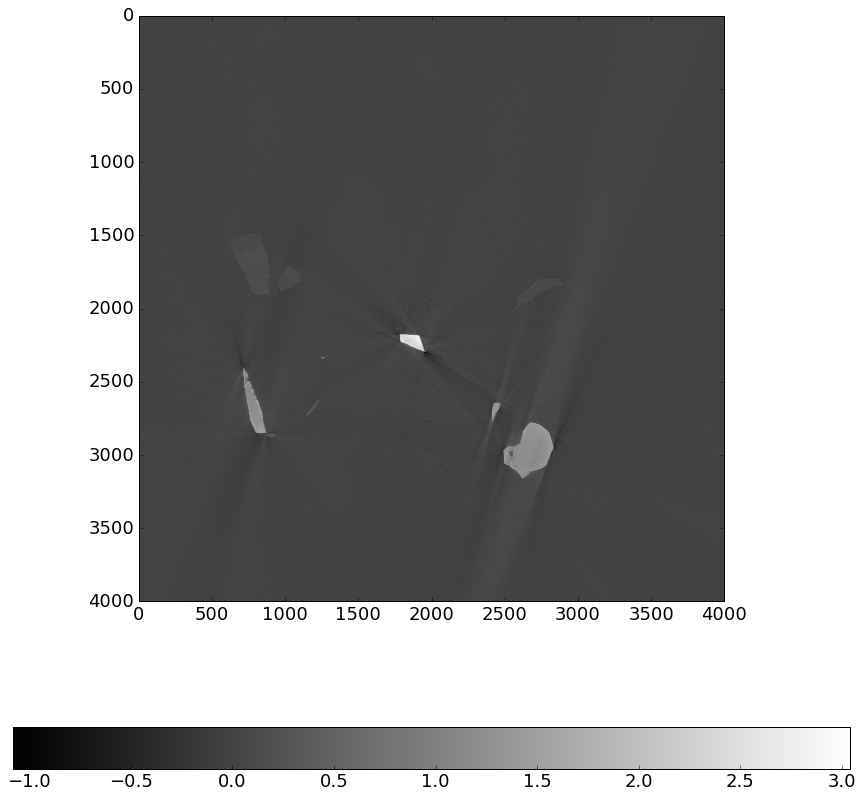

In [7]:
r,_=get_reconstruction_fbp(sinogram0_bh)
plt.figure(figsize=(15,15))
plt.imshow(r, cmap=plt.cm.gray)
plt.colorbar(orientation='horizontal')

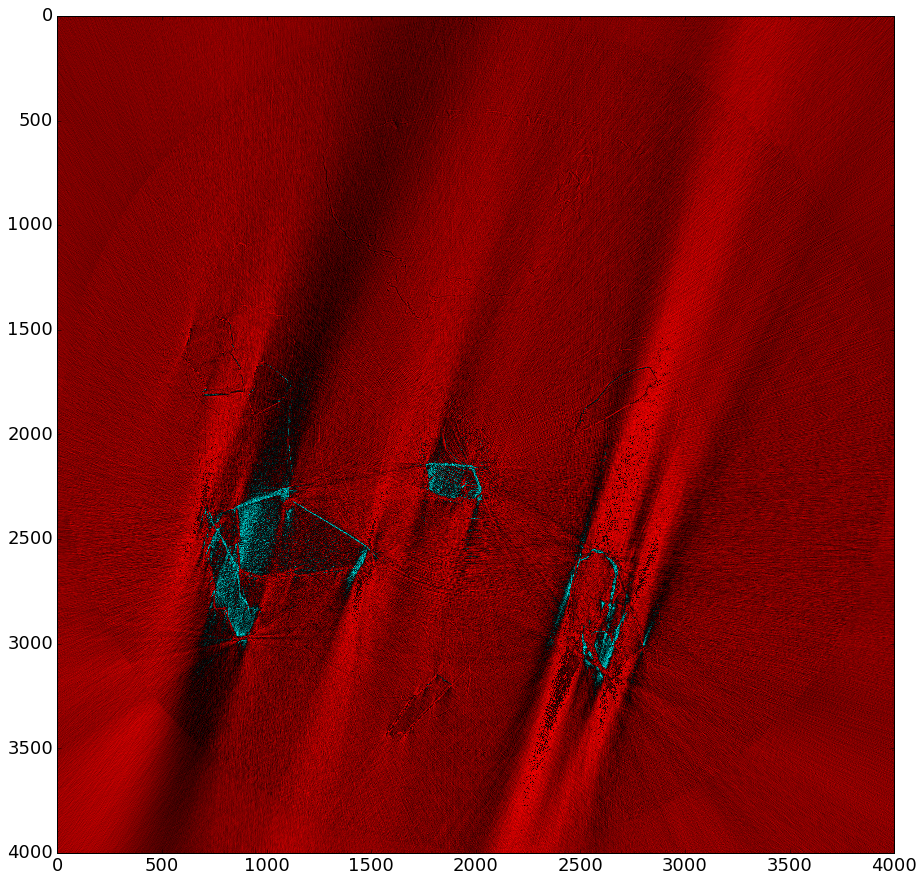

In [114]:
plt.figure(figsize=(15,15))
plt.imshow(18*images_diff(r, rec1040[...,0]))

In [106]:
rec1040.shape

(4000, 4000, 3)

In [83]:
recs=[]
for i in range(0,300,10):
    r,_=get_reconstruction_fbp(sinogram0[i:])
    recs.append([i,r])
# plt.figure(figsize=(10,12))
# plt.imshow(r, cmap=plt.cm.gray)
# plt.colorbar(orientation='horizontal')

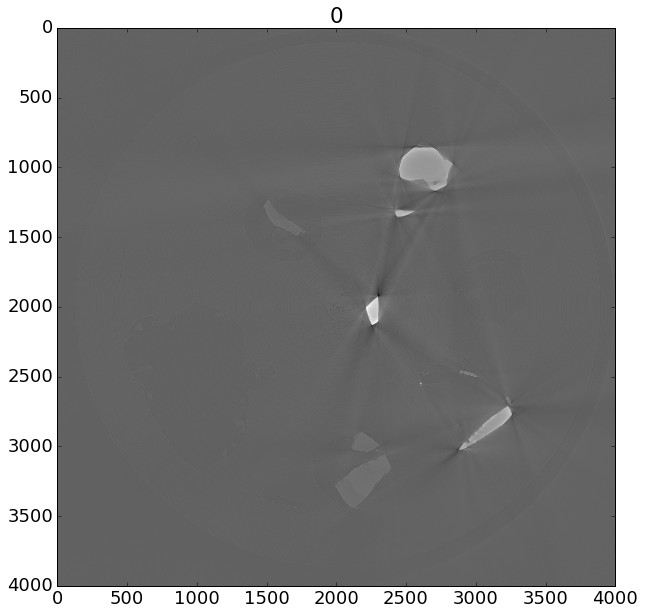

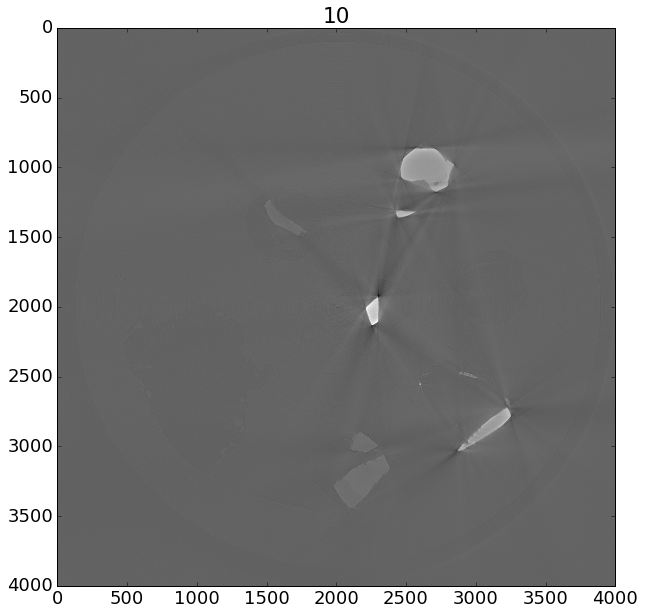

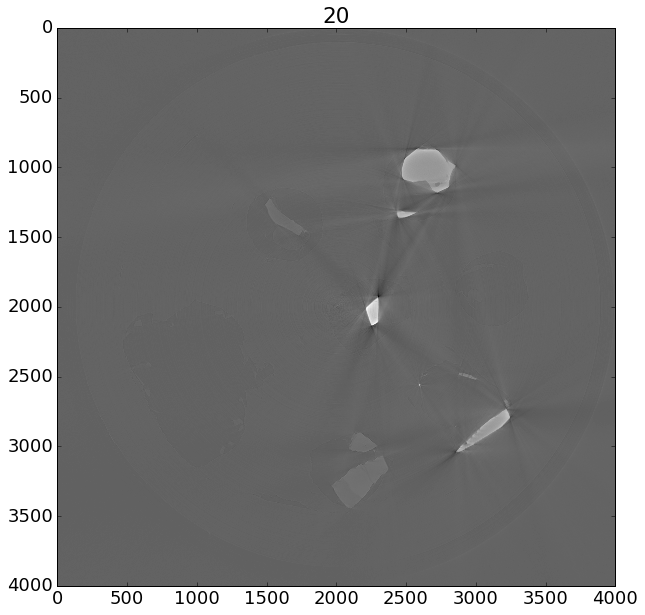

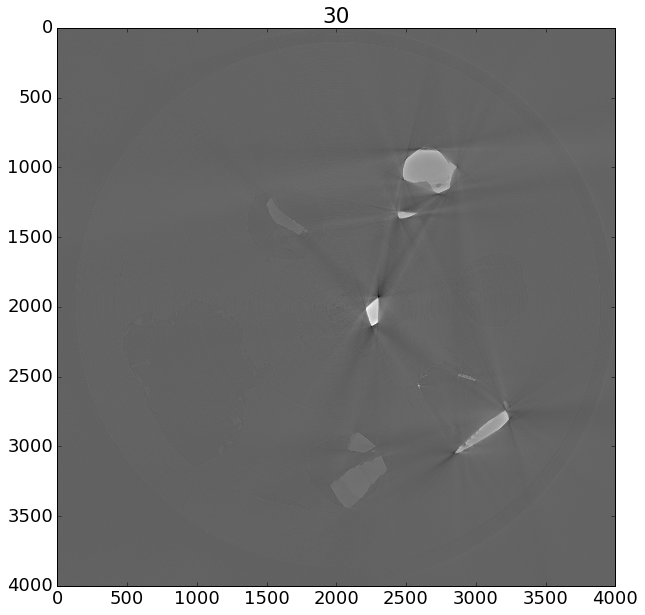

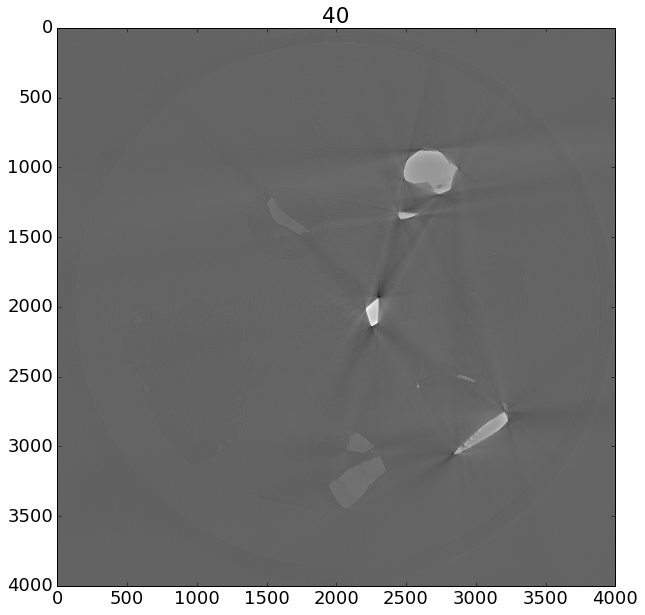

...

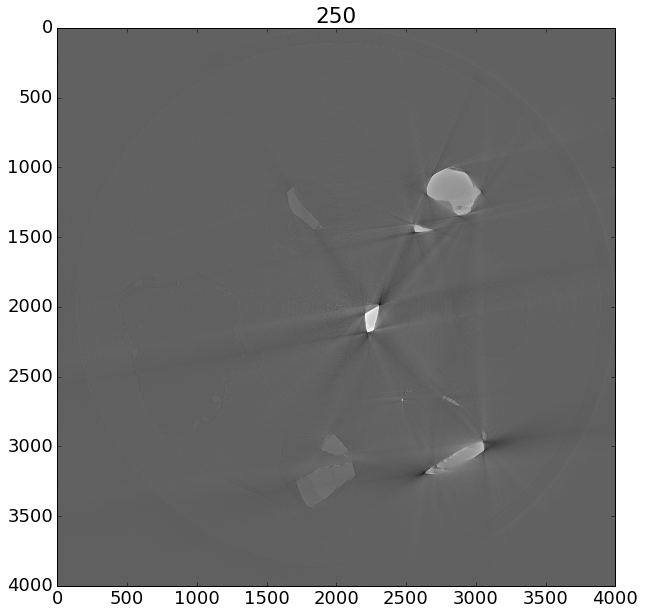

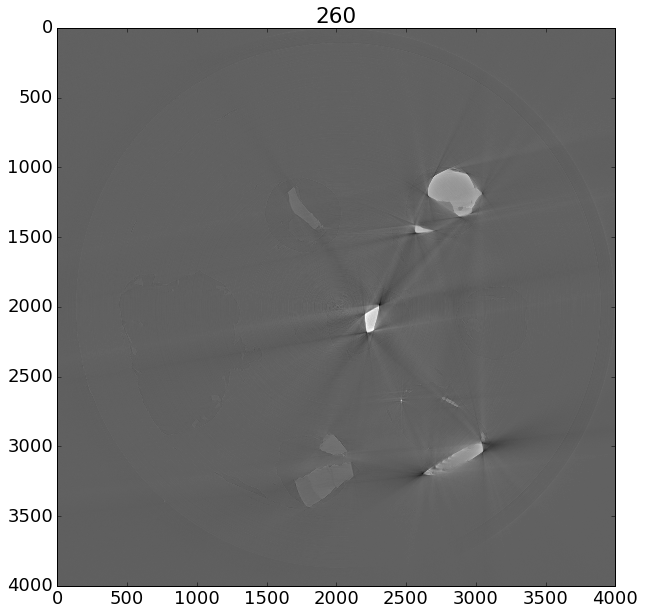

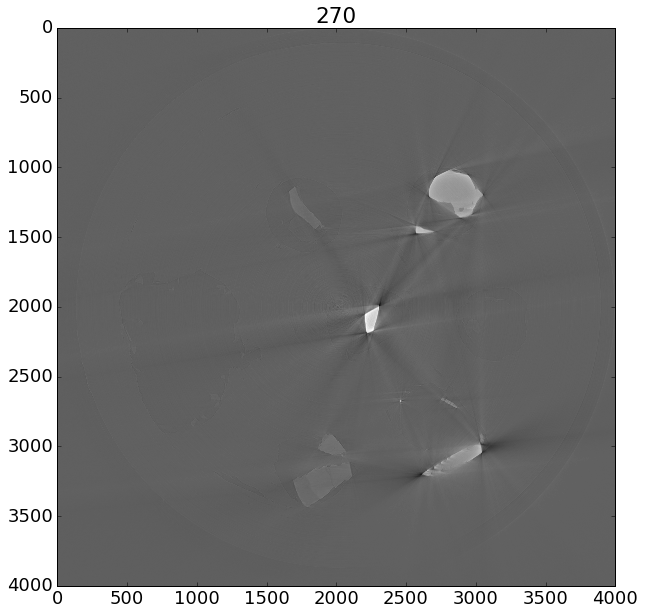

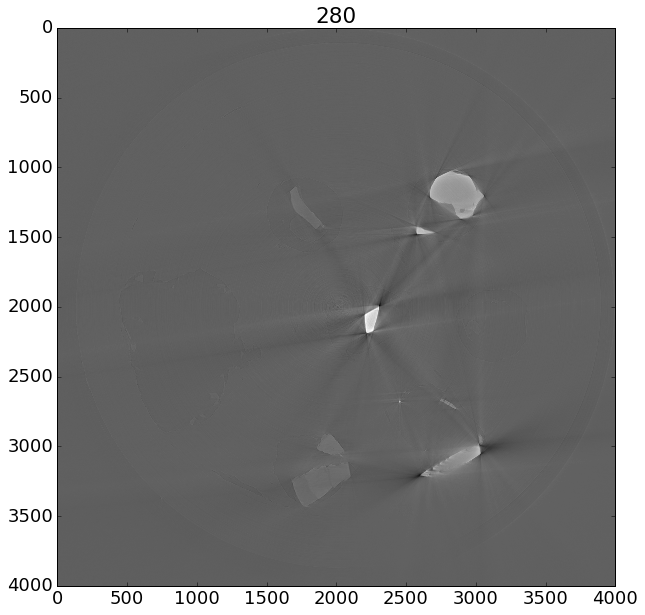

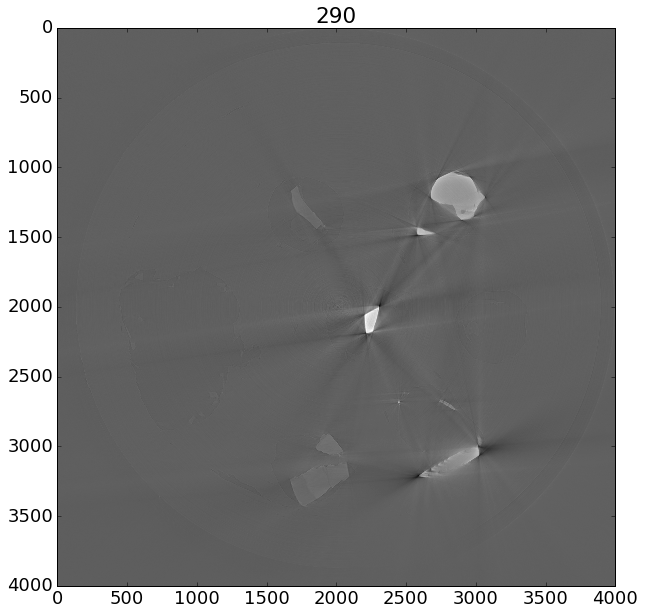

In [86]:
for i,r in recs:
    plt.figure(figsize=(10,12))
    plt.imshow(r, cmap=plt.cm.gray)
    plt.title(i)
    plt.show()

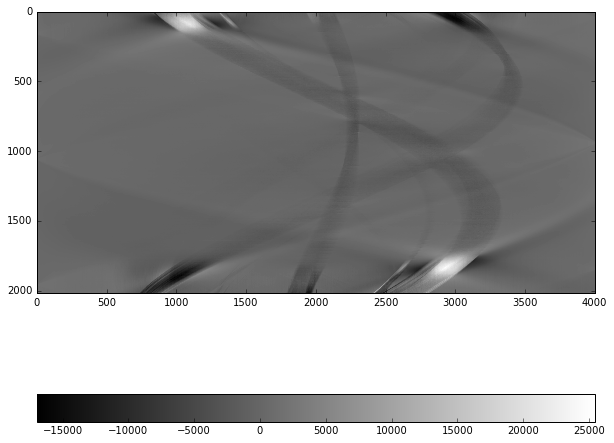

In [278]:
ts = s[-1]/s[-1].max()*sinogram0[:1800+220].max()
ts=np.flipud(ts)
plt.figure(figsize=(10,12))
plt.imshow(ts-sinogram0[:1800+220], cmap=plt.cm.gray)
plt.colorbar(orientation='horizontal')

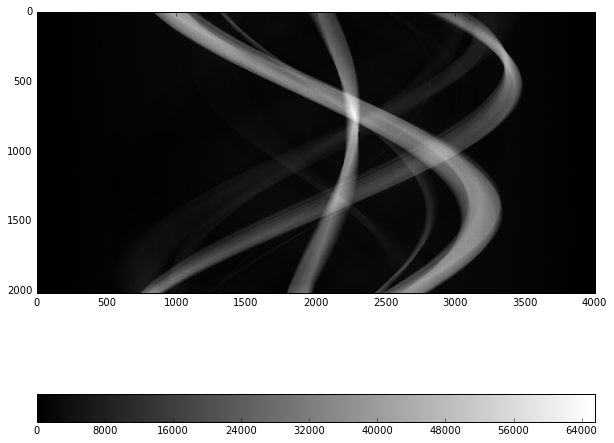

In [279]:
ts = s[-1]/s[-1].max()*2**16
ts=np.flipud(ts)
plt.figure(figsize=(10,12))
plt.imshow(sinogram0[:1800+220], cmap=plt.cm.gray)
plt.colorbar(orientation='horizontal')

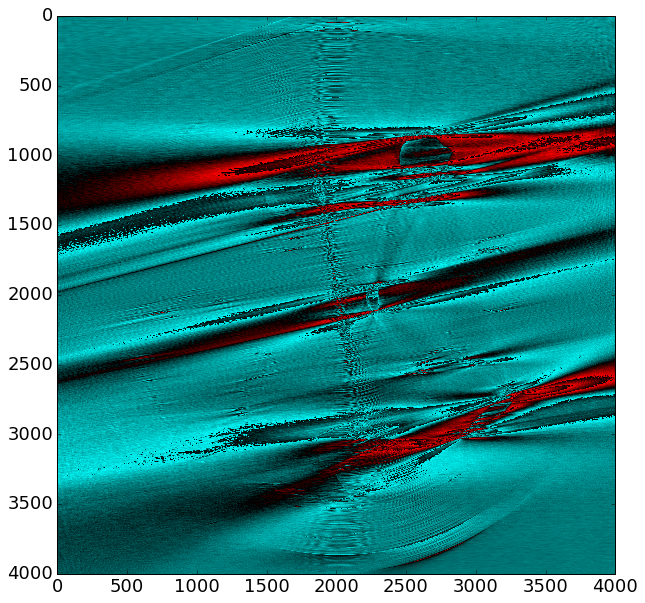

In [76]:
plt.figure(figsize=(10,10))
plt.imshow(100*images_diff(r,r1))

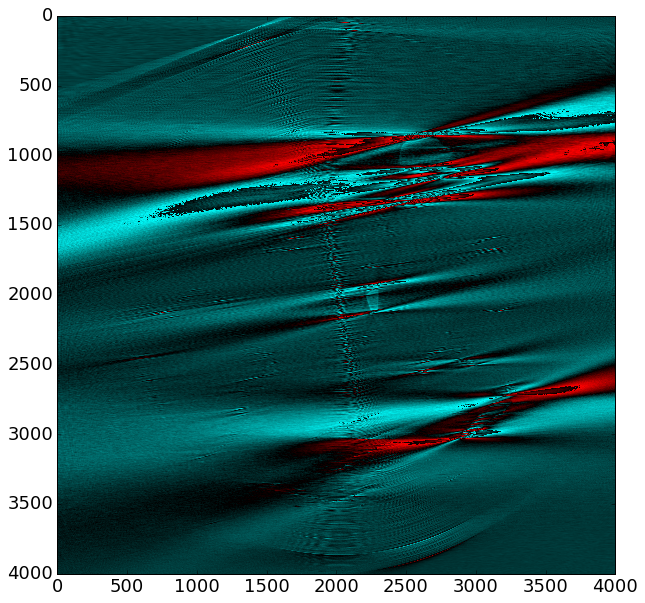

In [78]:
plt.figure(figsize=(10,10))
plt.imshow(100*images_diff(r,r1))

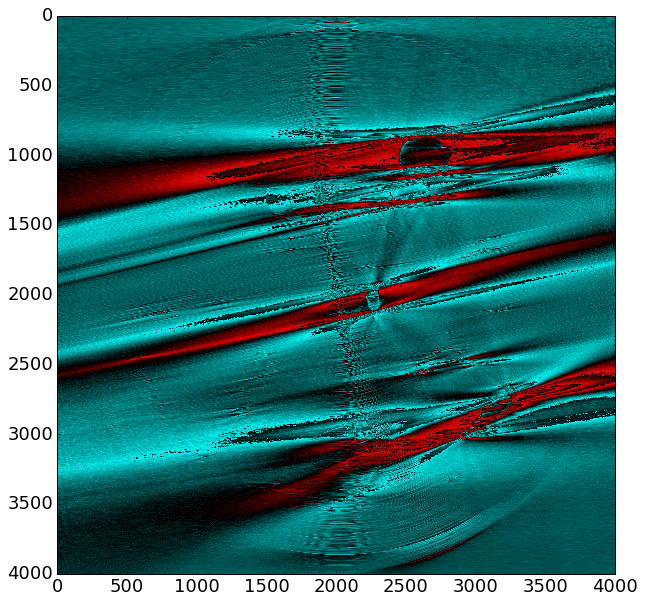

In [82]:
plt.figure(figsize=(10,10))
plt.imshow(100*images_diff(r,r1))

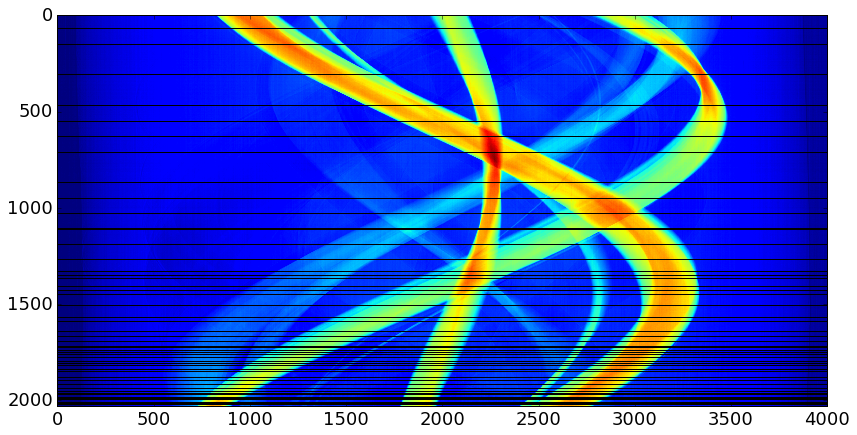

In [53]:
s0=np.diff(sinogram10[:,2000]-sinogram0[:,2000])
edges = np.argwhere(np.abs(s0)>5)
plt.figure(figsize=(15,7))
plt.imshow(sinogram0)
for ed in edges:
    plt.hlines(ed[0],0,4000,'k')
# plt.grid(True)
# plt.legend(loc=0)
plt.show()

In [59]:
data_files_0 = os.path.join('/home/makov/Downloads/multislice/bh_0_rc_0/', 'MMC1_2.82um__sino????.tif')
sinograms_0 = sorted(glob.glob(data_files_0))
print(len(sinograms_0))
data_files_17 = os.path.join('/home/makov/Downloads/multislice/bh_0_rc_17/', 'MMC1_2.82um__sino????.tif')
sinograms_17 = sorted(glob.glob(data_files_17))
print(len(sinograms_17))

121
121


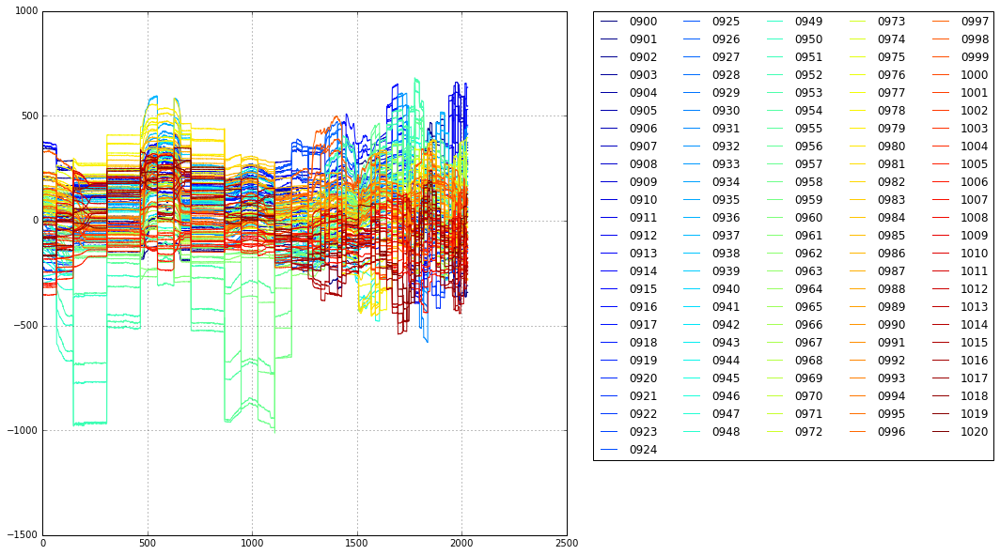

In [71]:
plt.figure(figsize=(10,10))
colormap = plt.cm.jet
plt.gca().set_color_cycle([colormap(k) for k in np.linspace(0, 1, len(sinograms_0))])
for s0,s17 in zip(sinograms_0,sinograms_17):
    d0 = plt.imread(s0).astype('float32')[:,2000]
    d17 = plt.imread(s17).astype('float32')[:,2000]
    plt.plot(d17-d0,label=s0[-8:-4])
    plt.hold(True)
plt.grid(True)
plt.legend(ncol=5,bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

In [93]:
files = glob.glob('/home/makov/diskmnt/big/yaivan/MMC_1/Raw/*_????.tif')

In [94]:
len(files)

2030

In [95]:
files

['/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_0649.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_1197.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_0976.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_0700.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_0248.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_0758.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_0543.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_1327.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_1252.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_0415.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_0419.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_1597.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_1945.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_1607.tif',
 '/home/makov/diskmnt/big/yaivan/MMC_1/Raw/MMC1_2.82um_0157.tif',
 '/home/ma

In [101]:
%xmodex

Exception reporting mode: Context


In [103]:
numbers = [int(x[-8:-4]) for x in files if not 'arc' in x]
numbers = sorted(numbers)

In [89]:
numbersx

['0649',
 '1197',
 '0976',
 '0700',
 '0248',
 '0758',
 '0543',
 '1327',
 '1252',
 '0415',
 '0419',
 '1597',
 '1945',
 '1607',
 '0157',
 '0174',
 '0300',
 '0492',
 '1315',
 '0854',
 '0608',
 '0158',
 '1761',
 '1418',
 '0253',
 '1668',
 '0564',
 '1724',
 '1553',
 '1970',
 '0425',
 '2019',
 '1231',
 '0497',
 '0225',
 '1617',
 '1968',
 '1189',
 '0996',
 '0147',
 '1480',
 '0240',
 '1102',
 '1725',
 '0686',
 '0704',
 '0004',
 '1922',
 '1114',
 '1722',
 '1399',
 '1647',
 '1747',
 '1376',
 '0523',
 '1838',
 '0853',
 '1292',
 '1030',
 '0766',
 '0583',
 '0389',
 '1224',
 '1393',
 '0514',
 '1200',
 '0840',
 '0108',
 '1422',
 '1336',
 '0812',
 '0084',
 '0396',
 '1598',
 '1983',
 '1899',
 '0596',
 '0779',
 '0294',
 '1329',
 '0299',
 '0752',
 '0889',
 '0316',
 '1138',
 '1844',
 '1463',
 '1996',
 '1799',
 '0346',
 '1082',
 '0115',
 '0428',
 '1075',
 '0328',
 '0413',
 '0719',
 '0409',
 '0321',
 '0604',
 '1436',
 '1645',
 '0018',
 '1641',
 '1300',
 '1477',
 '0490',
 '1845',
 '1671',
 '0075',
 '0749',
 

In [105]:
for i,n in enumerate(numbers):
    if not i == n:
        print i,n

In [107]:
numbers

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,
